# Autonomous Driving - Car Detection
Welcome to the **Autonomous Driving - Car Detection** project!  
In this notebook, we implement a simplified version of the YOLO object detection pipeline to identify cars in real-world images.

## What You'll See Here:
- Preprocessing images to feed into a YOLO model
- Converting YOLO model outputs to interpretable bounding boxes
- Filtering predictions using confidence scores and Non-Max Suppression (NMS)
- Visualizing the results with bounding boxes and class labels
- Optionally, saving predictions and generating video output

In [40]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import tensorflow as tf
from tensorflow.keras.models import load_model
from PIL import Image
import os

Filters YOLO-generated bounding boxes by applying a confidence threshold on both objectness and class probabilities. This step helps eliminate boxes with low prediction confidence, keeping only the most relevant detections.

In [5]:
def yolo_filter_boxes(box_confidence, boxes, box_class_probs, threshold = 0.6):
    """Filters YOLO boxes by thresholding on object and class confidence.
    Arguments:
    box_confidence -- tensor of shape (19, 19, 5, 1)
    boxes -- tensor of shape (19, 19, 5, 4) - (bx, by, bw, bh)
    box_class_probs -- tensor of shape (19, 19, 5, 80)

    Returns:
    scores -- containing the class probability score for selected boxes
    boxes -- containing (b_x, b_y, b_h, b_w) coordinates
    classes -- containing the index of the class detected by the selected boxes
    """

    # Calculate Class-Wise Box Scores
    box_scores = box_confidence * box_class_probs   # (19, 19, 5, 80)

    # best Class for each box
    box_classes = tf.argmax(box_scores, axis=-1) # (19, 19, 5)
    box_class_scores = tf.reduce_max(box_scores, axis=-1) # (19, 19, 5)

    # filter boxes, scores, and classes
    mask = box_class_scores >= threshold
    scores = tf.boolean_mask(box_class_scores, mask)
    boxes = tf.boolean_mask(boxes, mask)
    classes = tf.boolean_mask(box_classes, mask)

    return scores, boxes, classes

Performs Non-Maximum Suppression (NMS) on YOLO-predicted bounding boxes per class, keeping only the highest-scoring, non-overlapping boxes. This helps eliminate duplicate detections of the same object.

For each class:

* Pick the box with the highest score.

* Remove all other boxes that have IoU > threshold with it (high overlap).

* Repeat until no boxes are left.

In [6]:
def yolo_non_max_suppression(scores, boxes, classes, max_boxes=10, iou_thresh=0.5):
    """Implements Non-Maximum Suppression (NMS) on YOLO outputs, per class."""

    scores = tf.cast(scores, dtype=tf.float32)
    boxes = tf.cast(boxes, dtype=tf.float32)
    classes = tf.cast(classes, dtype=tf.int32)

    # Get unique class labels as numpy array for Python loop
    unique_classes = tf.unique(classes)[0].numpy()

    nms_boxes = []
    nms_scores = []
    nms_classes = []

    for label in unique_classes:
        mask = classes == label
        scores_ = tf.boolean_mask(scores, mask)
        boxes_ = tf.boolean_mask(boxes, mask)

        if tf.shape(scores_)[0] > 0:
            indices = tf.image.non_max_suppression(boxes_, scores_, max_output_size=max_boxes, iou_threshold=iou_thresh)
            nms_boxes.append(tf.gather(boxes_, indices))
            nms_scores.append(tf.gather(scores_, indices))
            nms_classes.append(tf.fill([tf.shape(indices)[0]], label))  # preserve class label

    if len(nms_boxes) == 0:
        return tf.zeros((0, 4)), tf.zeros((0,)), tf.zeros((0,), dtype=tf.int32)

    return (
        tf.concat(nms_boxes, axis=0),
        tf.concat(nms_scores, axis=0),
        tf.concat(nms_classes, axis=0)
    )

Converts YOLO box predictions from center format (x, y, w, h) to corner format [top, left, bottom, right] or [y_min, x_min, y_max, x_max].
This is essential for visualization and post-processing like Non-Maximum Suppression (NMS).

In [23]:
def yolo_boxes_to_corners(box_xy, box_wh):
    """Convert YOLO box predictions to bounding box corners."""

    box_mins = box_xy - box_wh / 2  # top-left corner
    box_maxes = box_xy + box_wh / 2  # bottom-right corner

    return tf.concat([
        box_mins[..., 1:2],  # y_min
        box_mins[..., 0:1],  # x_min
        box_maxes[..., 1:2],  # y_max
        box_maxes[..., 0:1]  # x_max
    ], axis=-1)

In [24]:
def scale_boxes(boxes, image_shape):
    """ Scales the predicted boxes in order to be drawable on the image"""
    height = image_shape[0]
    width = image_shape[1]
    image_dims = tf.cast([height, width, height, width], dtype=tf.float32)
    boxes = boxes * image_dims
    return boxes

This Function Processes the raw outputs of a YOLO model to generate the final predictions: bounding boxes, scores, and class labels.
It performs the following in order:

* Convert center-format boxes to corner-format.

* Filter low-confidence boxes.

* Rescale boxes to the original image size.

* Apply Non-Maximum Suppression (NMS) to remove overlapping boxes.


In [25]:
def yolo_eval(yolo_outputs, image_shape, max_boxes=10, score_threshold=.6, iou_threshold=.5):
    """Converts the output of YOLO encoding (a lot of boxes) to your predicted boxes along with their scores, box coordinates and classes.
    yolo_outputs -- output of the encoding model (for image_shape of (608, 608, 3)), contains 4 tensors:
                    box_xy: tensor of shape (None, 19, 19, 5, 2)
                    box_wh: tensor of shape (None, 19, 19, 5, 2
                    box_confidence: tensor of shape (None, 19, 19, 5, 1)
                    box_class_probs: tensor of shape (None, 19, 19, 5, 80)
    """

    box_xy, box_wh, box_confidence, box_class_probs = yolo_outputs
    
    boxes = yolo_boxes_to_corners(box_xy, box_wh)  # returns (19, 19, 5, 4)
    scores, boxes, classes = yolo_filter_boxes(box_confidence, boxes, box_class_probs, score_threshold)

    boxes = scale_boxes(boxes, image_shape)

    nms_boxes, nms_scores, nms_classes = yolo_non_max_suppression(scores, boxes, classes, max_boxes, iou_threshold)

    return nms_boxes, nms_scores, nms_classes

This function decodes the final output tensor of the YOLO convolutional network into interpretable bounding box predictions.
It converts center coordinates, box sizes, objectness confidence, and class probabilities into a form ready for filtering and evaluation.

In [26]:
def yolo_head(feats, anchors, num_classes):
    """
    Converts final YOLO conv layer output into box predictions.

    Args:
        feats: Tensor, shape (batch_size, grid_h, grid_w, num_anchors * (5 + num_classes))
        anchors: np.ndarray or list, shape (num_anchors, 2)
        num_classes: int, number of output classes

    Returns:
        box_xy: Center x, y coordinates (normalized)
        box_wh: Width and height (normalized)
        box_confidence: Objectness confidence
        box_class_probs: Class probabilities
    """
    num_anchors = len(anchors)
    grid_shape = tf.shape(feats)[1:3]  # height, width

    # Reshape output to (batch, grid_h, grid_w, num_anchors, 5 + num_classes)
    feats = tf.reshape(feats, (-1, grid_shape[0], grid_shape[1], num_anchors, 5 + num_classes))
    print('[yolo_head] feats reshaped:', feats.shape)

    # Split into components
    box_xy        = tf.sigmoid(feats[..., 0:2])  # x, y
    box_wh        = tf.exp(feats[..., 2:4])      # w, h
    box_conf      = tf.sigmoid(feats[..., 4:5])  # confidence
    box_class_probs = tf.nn.softmax(feats[..., 5:], axis=-1)  # class probs

    # Generate grid offsets (same shape as box_xy)
    grid_y = tf.range(grid_shape[0], dtype=tf.int32)
    grid_x = tf.range(grid_shape[1], dtype=tf.int32)
    grid_x, grid_y = tf.meshgrid(grid_x, grid_y)
    grid = tf.stack([grid_x, grid_y], axis=-1)
    grid = tf.cast(grid, tf.float32)
    grid = tf.reshape(grid, [1, grid_shape[0], grid_shape[1], 1, 2])  # shape (1, h, w, 1, 2)

    # Normalize and scale
    anchors = tf.cast(anchors, tf.float32)
    anchors = tf.reshape(anchors, [1, 1, 1, num_anchors, 2])
    box_xy = (box_xy + grid) / tf.cast(grid_shape[::-1], tf.float32)
    box_wh = box_wh * anchors / tf.cast(grid_shape[::-1], tf.float32)

    return box_xy, box_wh, box_conf, box_class_probs

In [27]:
def read_classes(classes_path):
    with open(classes_path) as f:
        class_names = f.readlines()
    class_names = [c.strip() for c in class_names]
    return class_names


def read_anchors(anchors_path):
    with open(anchors_path) as f:
        anchors = f.readline()
        anchors = [float(x) for x in anchors.split(',')]
        anchors = np.array(anchors).reshape(-1, 2)
    return anchors

In [28]:
def preprocess_image(image_path, image_size=(608, 608)):
    """Preprocess the input image to be compatible with YOLO model."""
    image = tf.image.decode_image(tf.io.read_file(image_path), channels=3)
    image = tf.image.resize(image, image_size)
    image = tf.cast(image, dtype=tf.float32) / 255.0  # normalize to [0, 1]
    return image

Image size: (1280, 720)


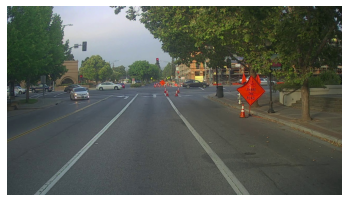

In [29]:
path = 'images/0003.jpg'
img = Image.open(path)
print("Image size:", img.size)
plt.imshow(img)
plt.axis('off')
plt.show()

Processed Image Shape: (608, 608, 3)


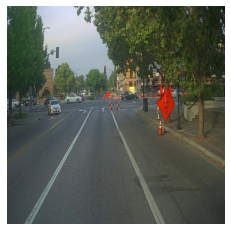

In [30]:
processed_image = preprocess_image(path, (608, 608))
print("Processed Image Shape:", processed_image.shape)
plt.imshow(processed_image.numpy())  # convert tensor to NumPy
plt.axis('off')
plt.show()

In [31]:
class_names = read_classes('model_data/coco_classes.txt')
anchors = read_anchors('model_data/yolo_anchors.txt')
image_size = (608, 608) # same as yolo model input size
print(class_names)
print(anchors)

['person', 'bicycle', 'car', 'motorbike', 'aeroplane', 'bus', 'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'stop sign', 'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow', 'elephant', 'bear', 'zebra', 'giraffe', 'backpack', 'umbrella', 'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball', 'kite', 'baseball bat', 'baseball glove', 'skateboard', 'surfboard', 'tennis racket', 'bottle', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza', 'donut', 'cake', 'chair', 'sofa', 'pottedplant', 'bed', 'diningtable', 'toilet', 'tvmonitor', 'laptop', 'mouse', 'remote', 'keyboard', 'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'book', 'clock', 'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush']
[[0.57273  0.677385]
 [1.87446  2.06253 ]
 [3.33843  5.47434 ]
 [7.88282  3.52778 ]
 [9.77052  9.16828 ]]


## Load Model - YOLOv2

In [32]:
yolo_model = load_model('model_data/', compile=False)

In [33]:
yolo_model.summary()

Model: "functional_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 608, 608, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 608, 608, 32) 864         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 608, 608, 32) 128         conv2d[0][0]                     
__________________________________________________________________________________________________
leaky_re_lu (LeakyReLU)         (None, 608, 608, 32) 0           batch_normalization[0][0]        
_______________________________________________________________________________________

## Prediction

In [34]:
def predict(image_file_path, model, class_names, anchors, image_shape=(608, 608)):
    """
    Predicts bounding boxes, class scores, and class labels for an input image using a YOLO model.

    Args:
        image_file_path (str): Path to the input image.
        model (tf.keras.Model): Pretrained YOLO model.
        class_names (list): List of class names corresponding to the model's output classes.
        anchors (np.ndarray): YOLO anchor boxes (shape: [N, 2]).
        image_shape (tuple, optional): Size to which the input image is resized before prediction. Defaults to (608, 608).

    Returns:
        tuple[np.ndarray, np.ndarray, np.ndarray]: 
            - boxes: Predicted bounding boxes, shape (N, 4) where each box is [top, left, bottom, right].
            - scores: Confidence scores for each box, shape (N,).
            - classes: Predicted class indices for each box, shape (N,).
    """
    
    original_image = Image.open(image_file_path)
    original_shape = original_image.size[::-1]
    
    # Load and preprocess the image
    image = preprocess_image(image_file_path, image_shape)

    # Add batch dimension: shape becomes (1, image_shape, 3)
    image_batch = tf.expand_dims(image, axis=0)

    # Get model predictions
    print('YOLO Input: (Input Image)', image_batch.shape)
    yolo_outputs = model(image_batch)
    print('YOLO Raw Output: (From model)', yolo_outputs.shape)
    
    yolo_outputs = yolo_head(yolo_outputs, anchors, len(class_names))
    box_xy, box_wh, box_confidence, box_class_probs = yolo_outputs
    print('YOLO Raw Output Processed (From yolo_head):', np.array(yolo_outputs).shape)
    print("box_xy shape:", box_xy.shape)
    print("box_wh shape:", box_wh.shape)
    print("box_confidence shape:", box_confidence.shape)
    print("box_class_probs shape:", box_class_probs.shape)
    print('-' * 50)
    
    # Evaluate the predictions (depends on your custom yolo_eval implementation)
    boxes, scores, classes = yolo_eval(yolo_outputs, original_shape, 10, 0.3, 0.5)
    print('-' * 50)
    print('From yolo_eval')
    print("boxes shape:", boxes.shape)
    print("scores shape:", scores.shape)
    print("classes shape:", classes.shape)
    
    return boxes.numpy(), scores.numpy(), classes.numpy()

In [ ]:
def display_predictions(image_path, boxes, scores, classes, class_names):
    boxes = np.array(boxes)
    scores = np.array(scores)
    classes = np.array(classes)

    if boxes.ndim == 1:
        boxes = np.expand_dims(boxes, axis=0)
        scores = np.expand_dims(scores, axis=0)
        classes = np.expand_dims(classes, axis=0)

    original_image = Image.open(image_path)
    width, height = original_image.size

    plt.figure(figsize=(15, 7))

    # 1. Show original image
    plt.subplot(1, 2, 1)
    plt.imshow(original_image)
    plt.title("Original Image")
    plt.axis('off')

    # 2. Show image with predicted boxes
    plt.subplot(1, 2, 2)
    plt.imshow(original_image)
    ax = plt.gca()
    
    for i in range(len(boxes)):
        top = boxes[i][0]
        left = boxes[i][1]
        bottom = boxes[i][2]
        right = boxes[i][3]
        score = scores[i]
        class_id = int(classes[i])
        class_name = class_names[class_id]

        # Draw bounding box
        rect = patches.Rectangle((left, top), right - left, bottom - top,
                                 linewidth=2, edgecolor='lime', facecolor='none')
        ax.add_patch(rect)

        label = f"{class_name} {score:.2f}"

        # Ensure label appears *just above* the box, not hiding it
        text_y = max(top - 20, 0)  # push text upward, stay within image
        ax.text(left, text_y, label,
                color='white', backgroundcolor='green', fontsize=10, weight='bold')

    plt.title("Predicted Boxes")
    plt.axis('off')
    plt.tight_layout()
    plt.show()

In [43]:
img1 = 'images/test.jpg'
img2 = 'images/giraffe.jpg'

YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (13, 4)
scores shape: (13,)
classes shape: (13,)


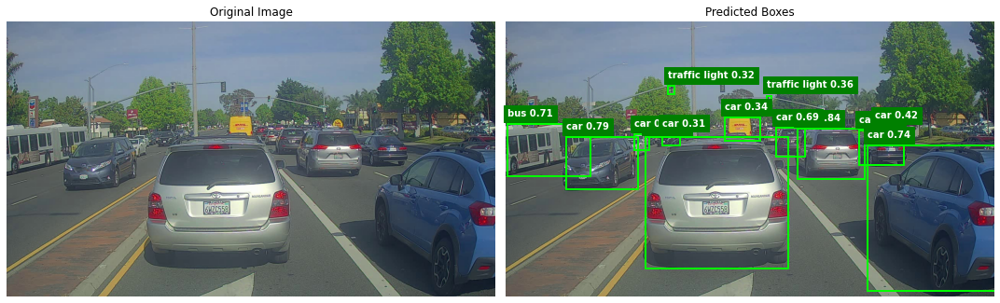

In [44]:
out_boxes, out_scores, out_classes = predict(img1, yolo_model, class_names, anchors, image_size)
display_predictions(img1, out_boxes, out_scores, out_classes, class_names)

YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (2, 4)
scores shape: (2,)
classes shape: (2,)


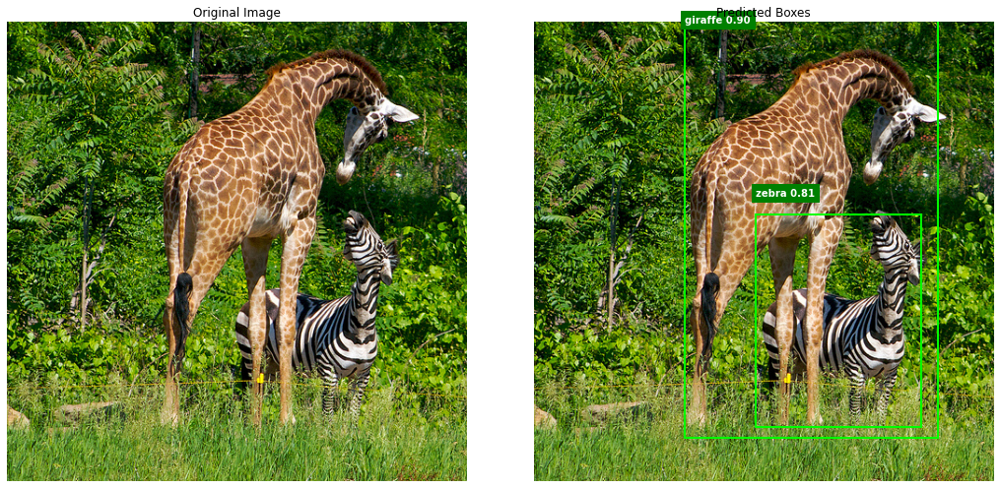

In [45]:
out_boxes, out_scores, out_classes = predict(img2, yolo_model, class_names, anchors, image_size)
display_predictions(img2, out_boxes, out_scores, out_classes, class_names)

Image not found: images/0000.jpg
Processing: 0001.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (6, 4)
scores shape: (6,)
classes shape: (6,)


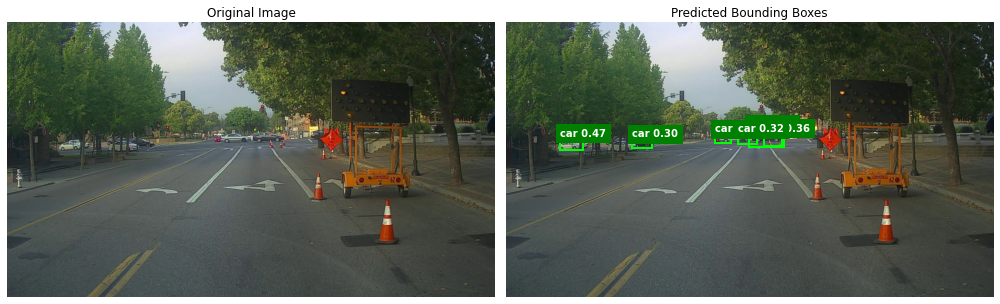

Processing: 0002.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (11, 4)
scores shape: (11,)
classes shape: (11,)


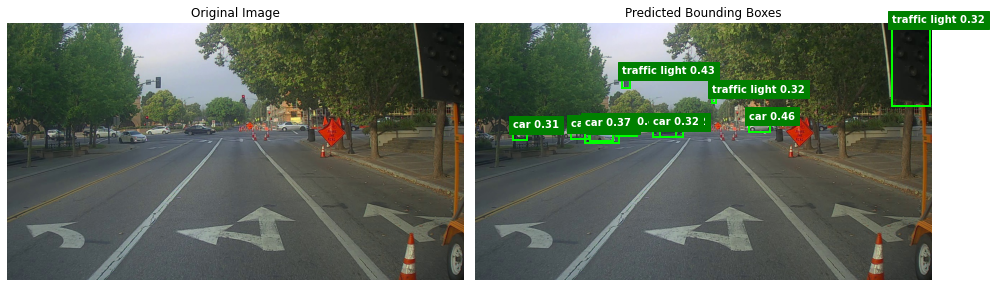

Processing: 0003.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (8, 4)
scores shape: (8,)
classes shape: (8,)


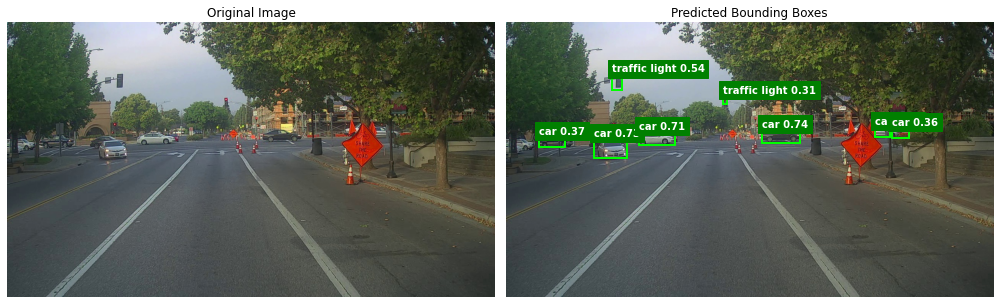

Processing: 0004.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (11, 4)
scores shape: (11,)
classes shape: (11,)


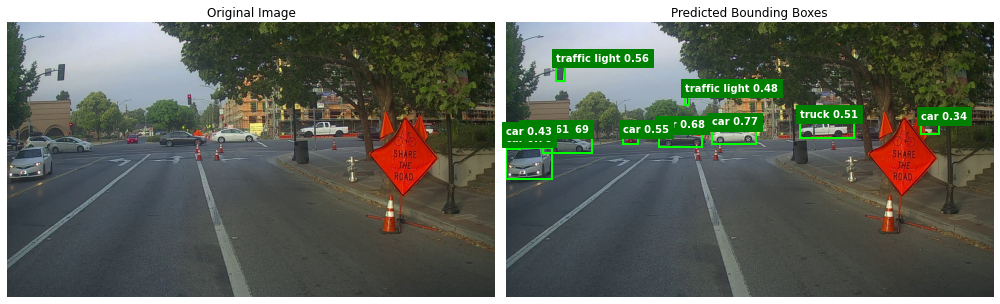

Processing: 0005.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (8, 4)
scores shape: (8,)
classes shape: (8,)


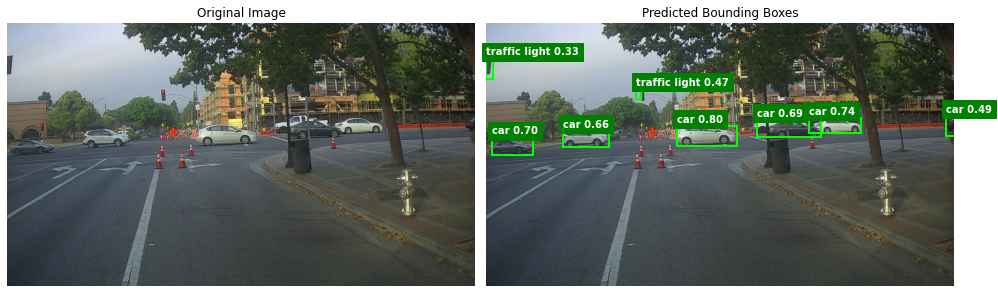

Processing: 0006.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (8, 4)
scores shape: (8,)
classes shape: (8,)


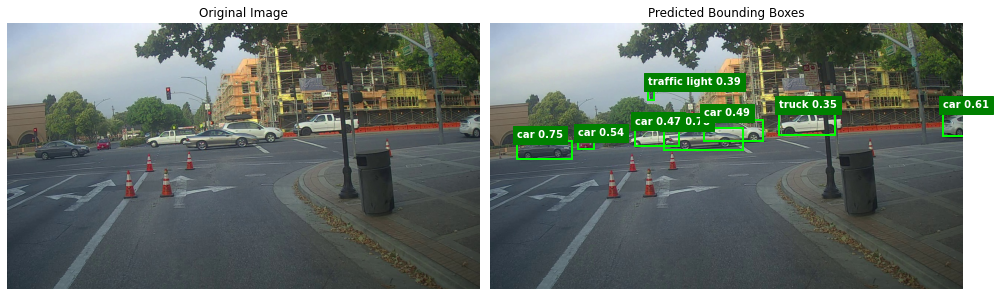

Processing: 0007.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (9, 4)
scores shape: (9,)
classes shape: (9,)


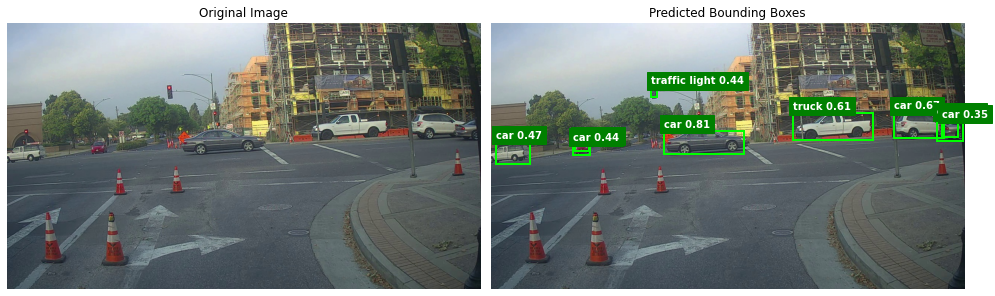

Processing: 0008.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (5, 4)
scores shape: (5,)
classes shape: (5,)


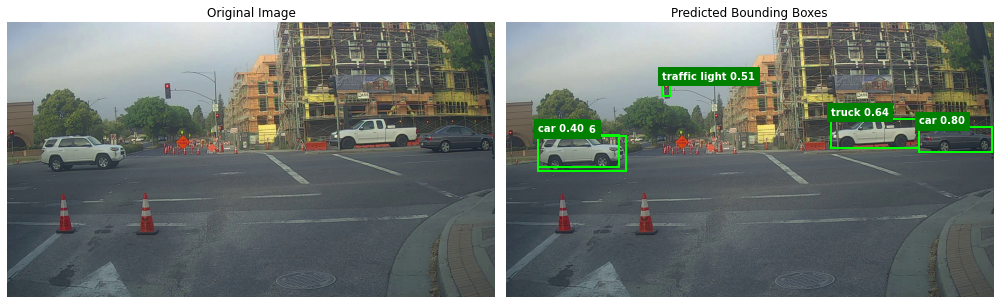

Processing: 0009.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (4, 4)
scores shape: (4,)
classes shape: (4,)


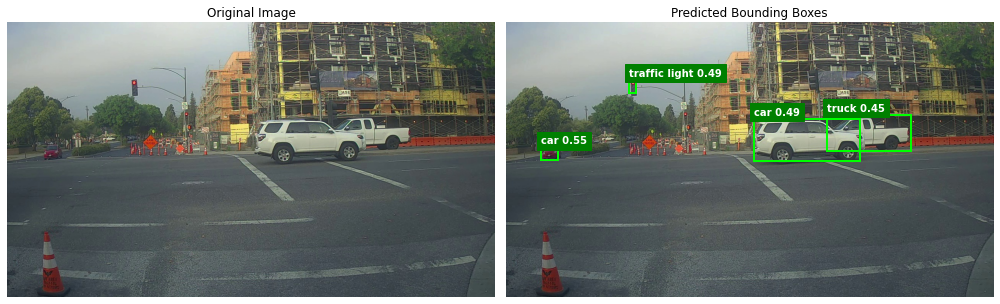

Processing: 0010.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (4, 4)
scores shape: (4,)
classes shape: (4,)


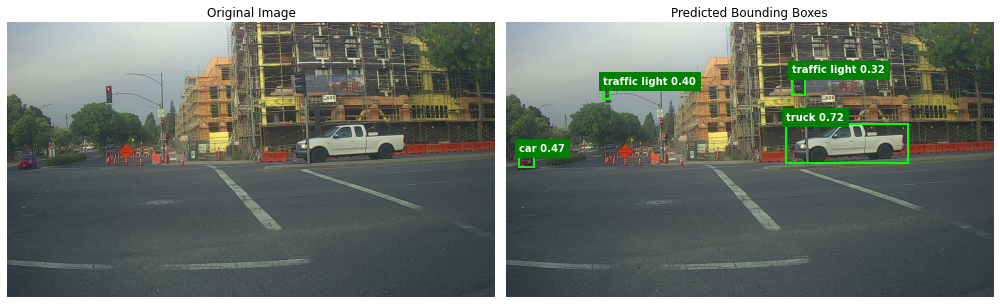

Processing: 0011.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (4, 4)
scores shape: (4,)
classes shape: (4,)


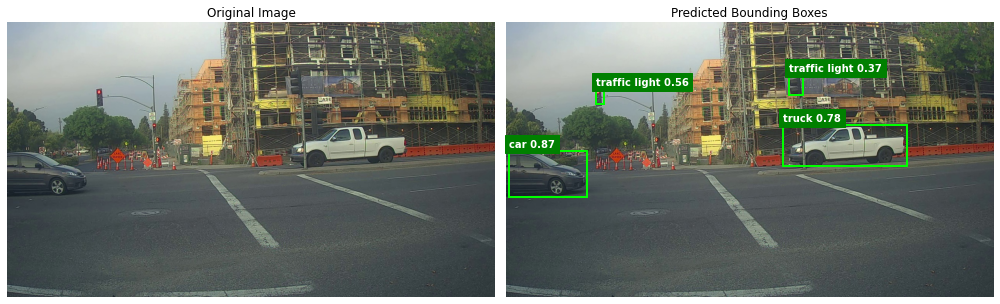

Processing: 0012.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (6, 4)
scores shape: (6,)
classes shape: (6,)


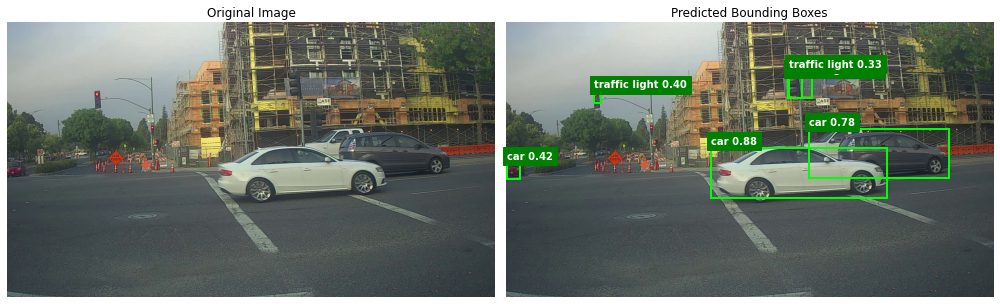

Processing: 0013.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (4, 4)
scores shape: (4,)
classes shape: (4,)


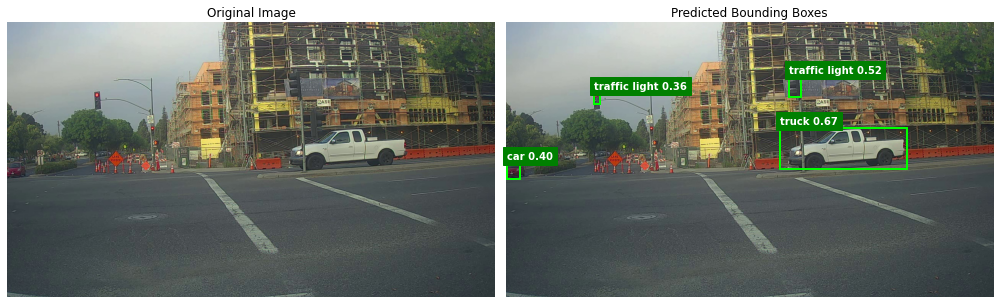

Processing: 0014.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (4, 4)
scores shape: (4,)
classes shape: (4,)


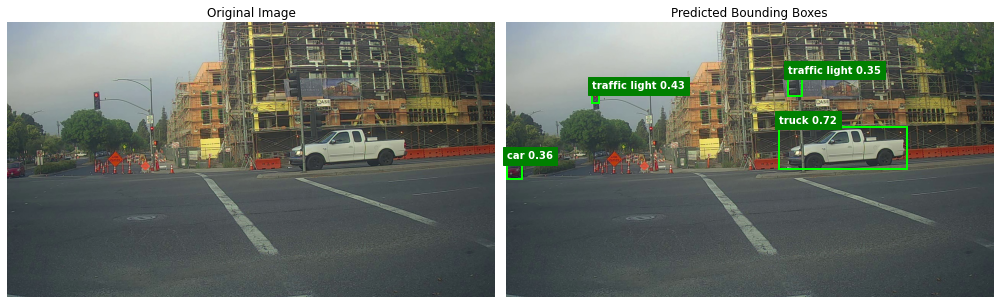

Processing: 0015.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (4, 4)
scores shape: (4,)
classes shape: (4,)


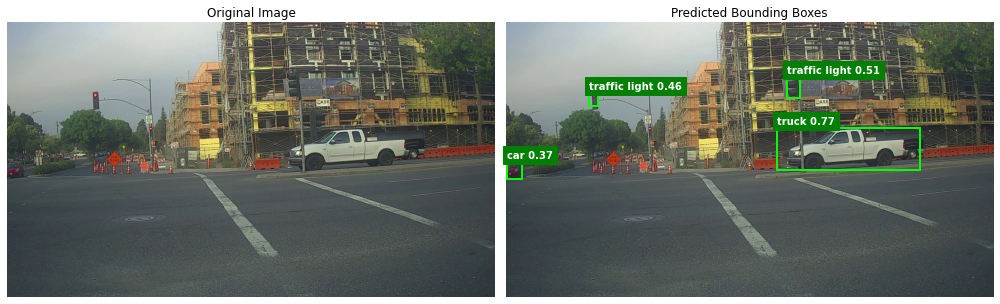

Processing: 0016.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (6, 4)
scores shape: (6,)
classes shape: (6,)


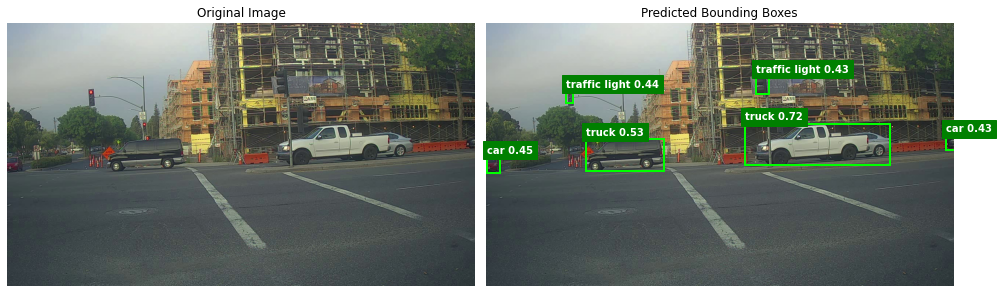

Processing: 0017.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (5, 4)
scores shape: (5,)
classes shape: (5,)


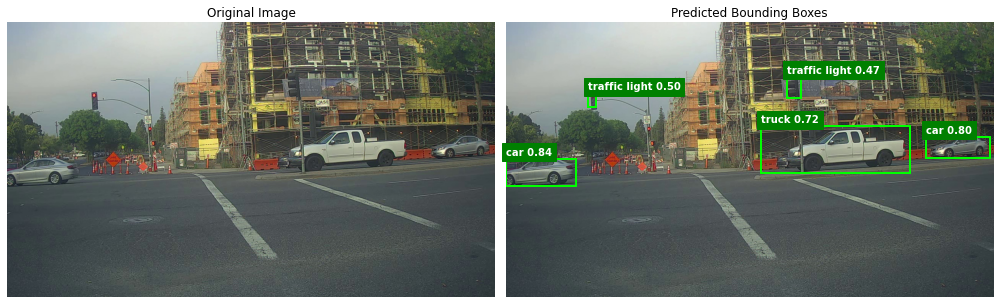

Processing: 0018.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (6, 4)
scores shape: (6,)
classes shape: (6,)


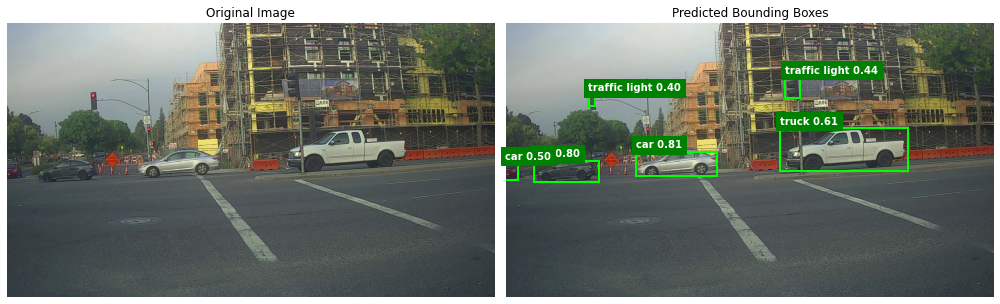

Processing: 0019.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (3, 4)
scores shape: (3,)
classes shape: (3,)


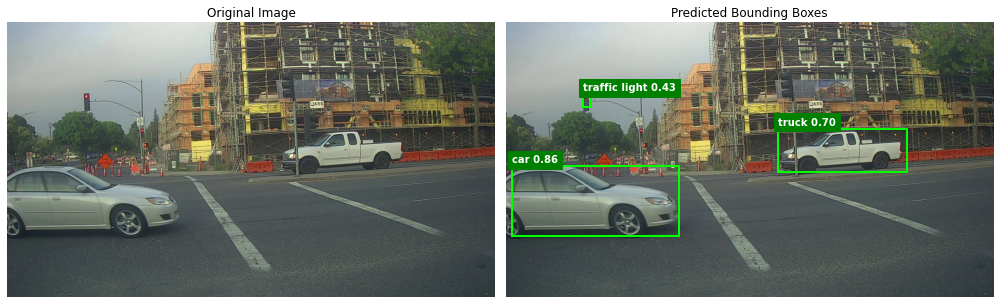

Processing: 0020.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (3, 4)
scores shape: (3,)
classes shape: (3,)


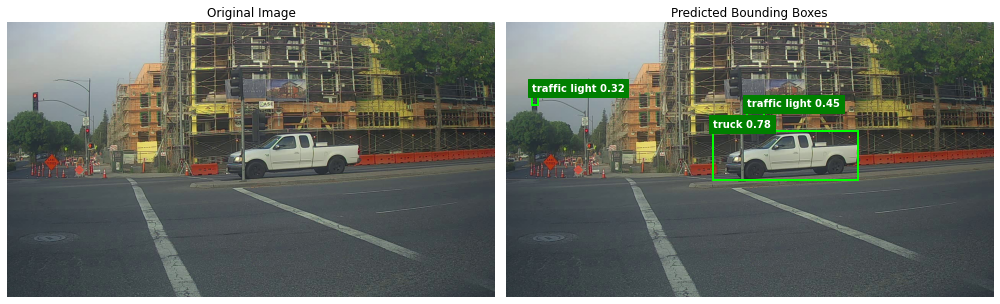

Processing: 0021.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (2, 4)
scores shape: (2,)
classes shape: (2,)


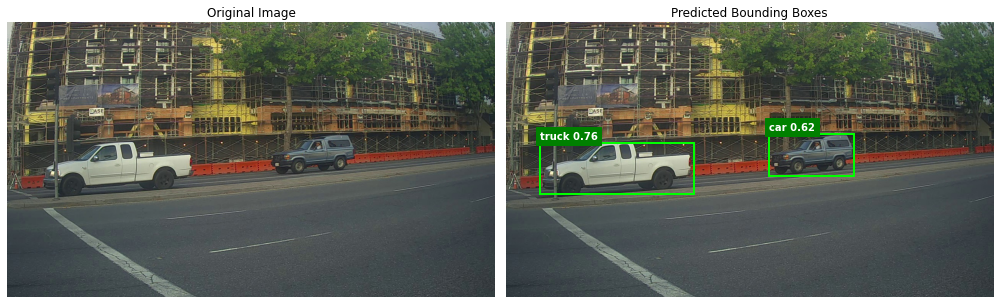

Processing: 0022.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (2, 4)
scores shape: (2,)
classes shape: (2,)


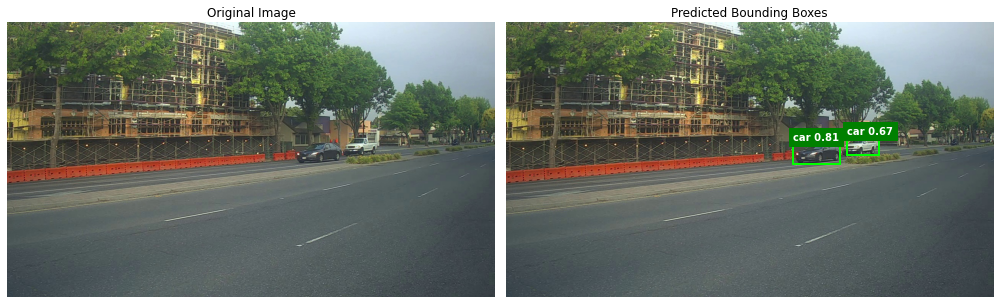

Processing: 0023.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (4, 4)
scores shape: (4,)
classes shape: (4,)


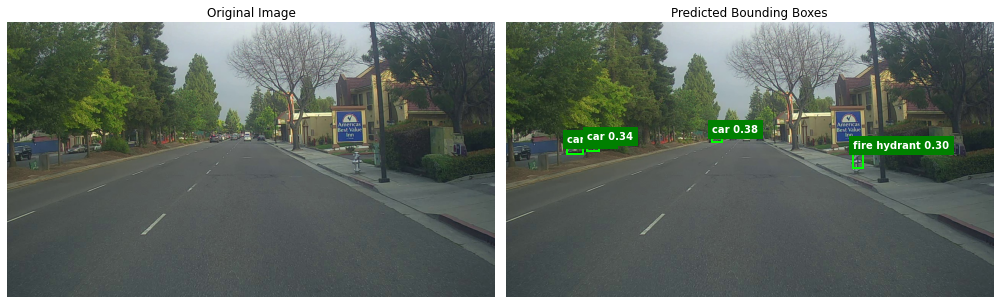

Processing: 0024.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (1, 4)
scores shape: (1,)
classes shape: (1,)


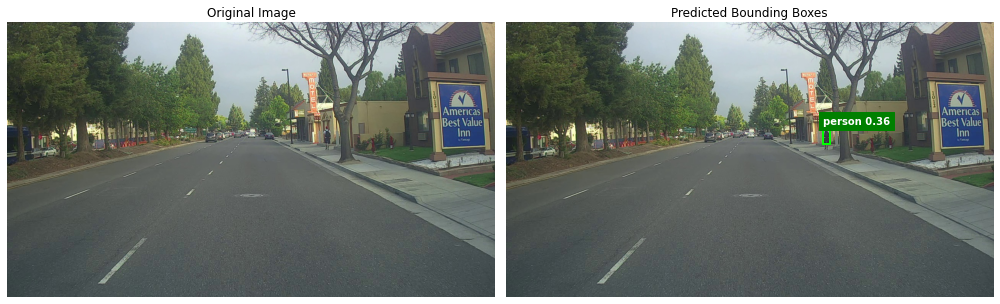

Processing: 0025.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (3, 4)
scores shape: (3,)
classes shape: (3,)


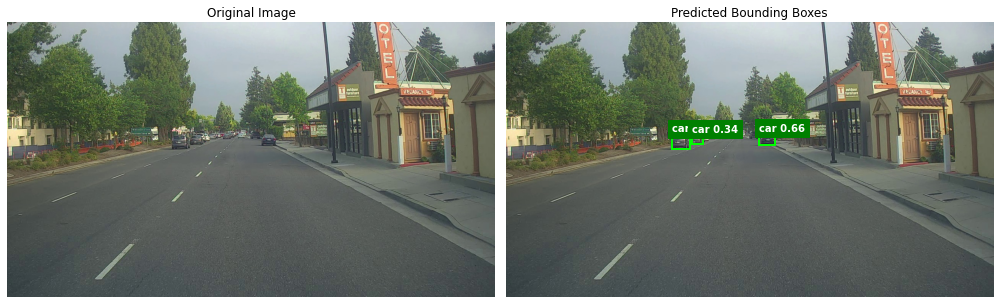

Processing: 0026.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (4, 4)
scores shape: (4,)
classes shape: (4,)


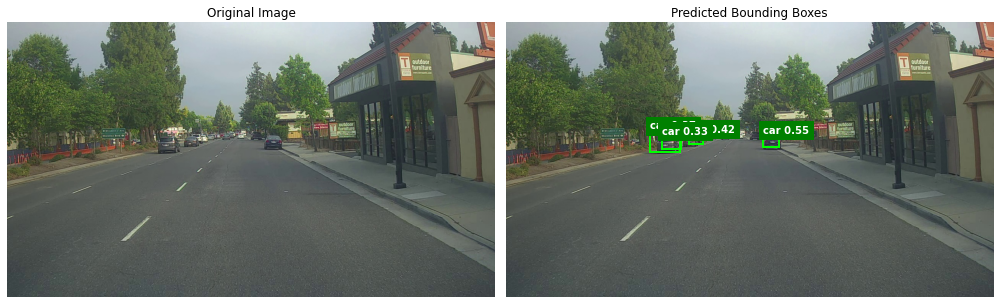

Processing: 0027.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (4, 4)
scores shape: (4,)
classes shape: (4,)


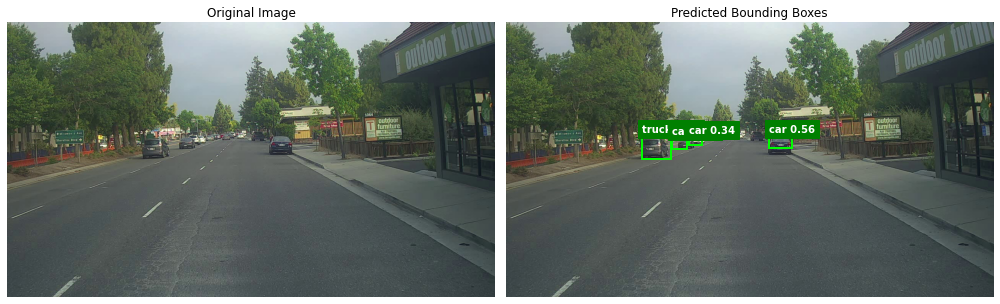

Processing: 0028.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (5, 4)
scores shape: (5,)
classes shape: (5,)


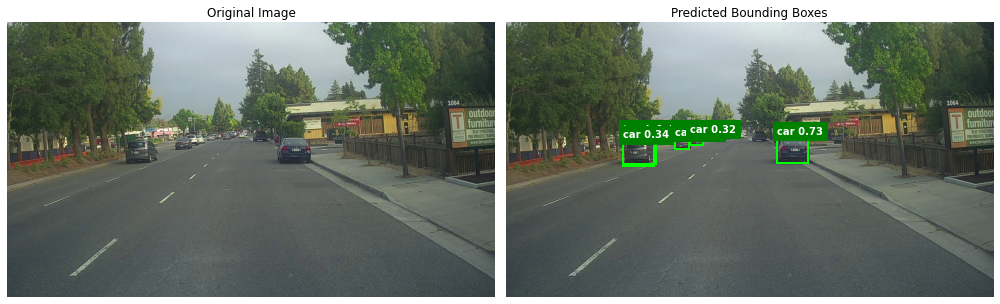

Processing: 0029.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (6, 4)
scores shape: (6,)
classes shape: (6,)


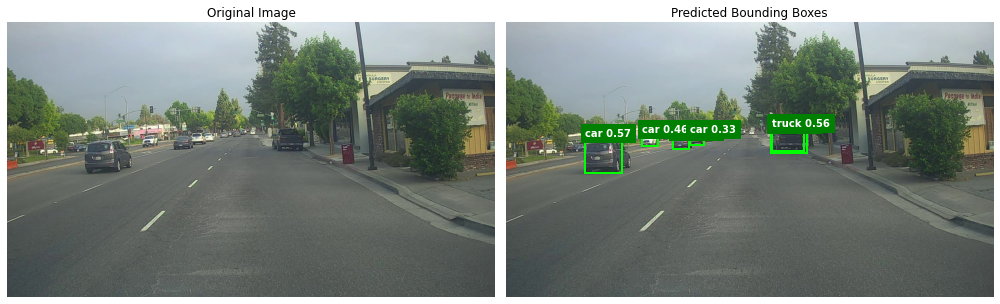

Processing: 0030.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (6, 4)
scores shape: (6,)
classes shape: (6,)


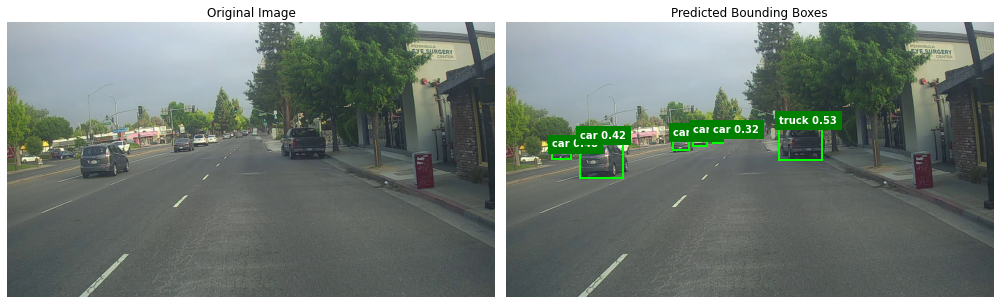

Processing: 0031.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (8, 4)
scores shape: (8,)
classes shape: (8,)


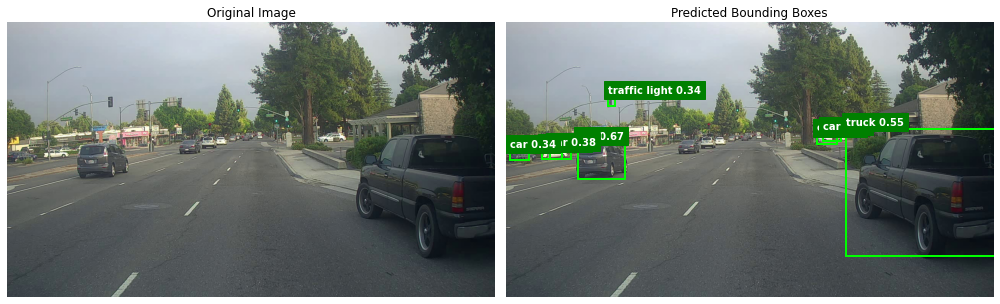

Processing: 0032.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (8, 4)
scores shape: (8,)
classes shape: (8,)


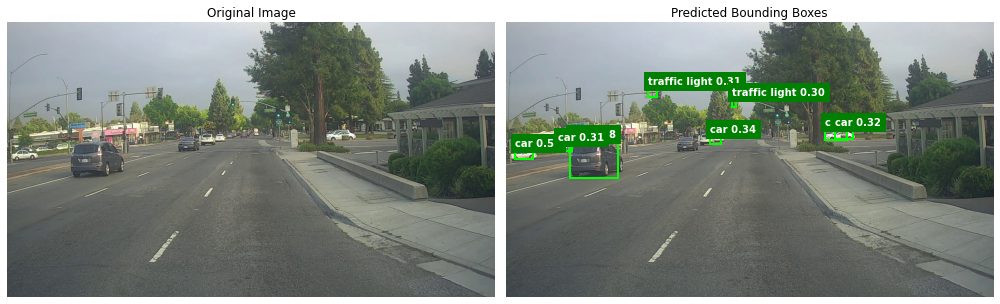

Processing: 0033.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (8, 4)
scores shape: (8,)
classes shape: (8,)


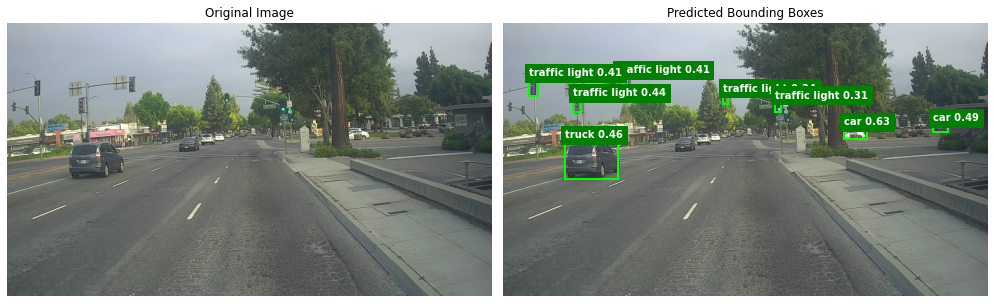

Processing: 0034.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (8, 4)
scores shape: (8,)
classes shape: (8,)


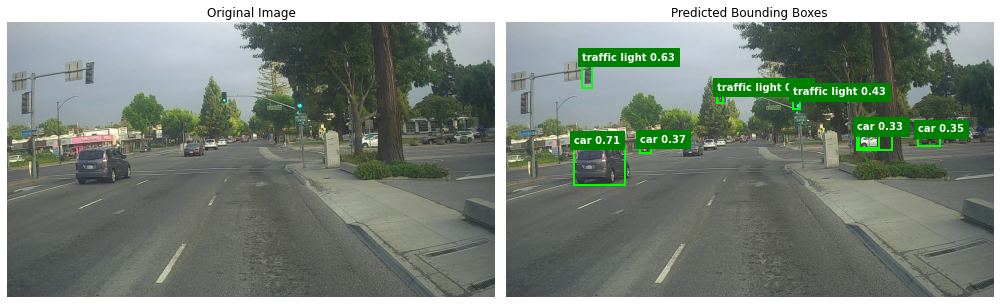

Processing: 0035.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (8, 4)
scores shape: (8,)
classes shape: (8,)


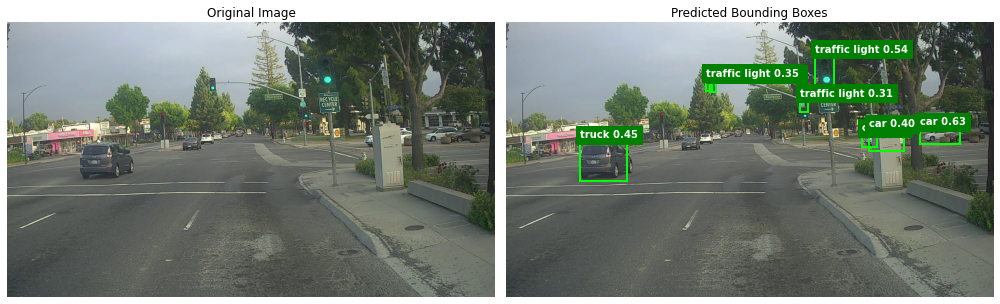

Processing: 0036.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (4, 4)
scores shape: (4,)
classes shape: (4,)


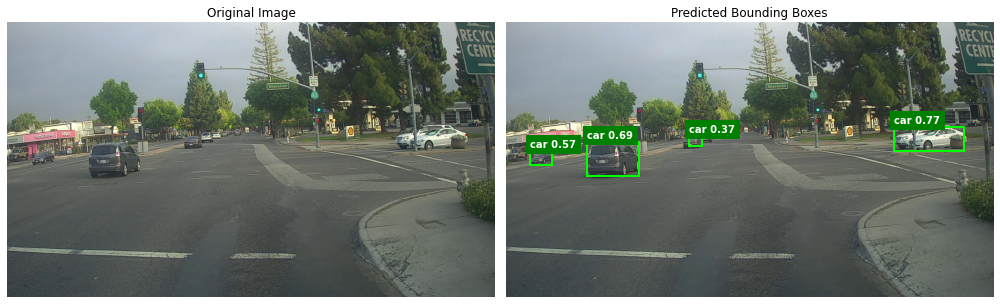

Processing: 0037.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (5, 4)
scores shape: (5,)
classes shape: (5,)


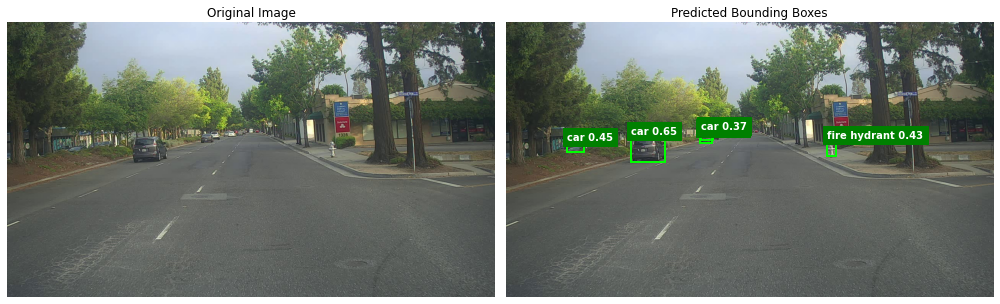

Processing: 0038.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (6, 4)
scores shape: (6,)
classes shape: (6,)


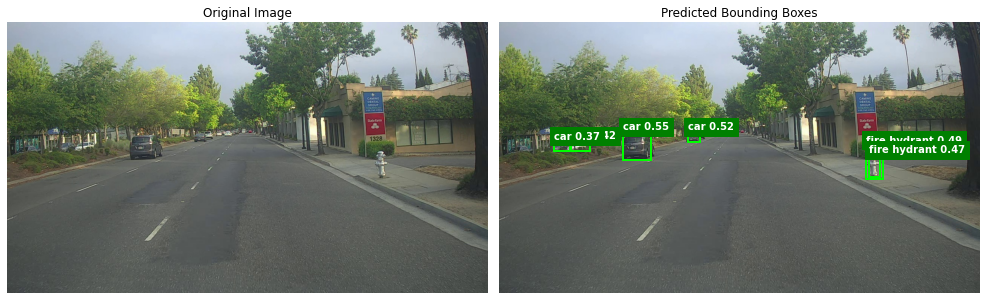

Processing: 0039.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (3, 4)
scores shape: (3,)
classes shape: (3,)


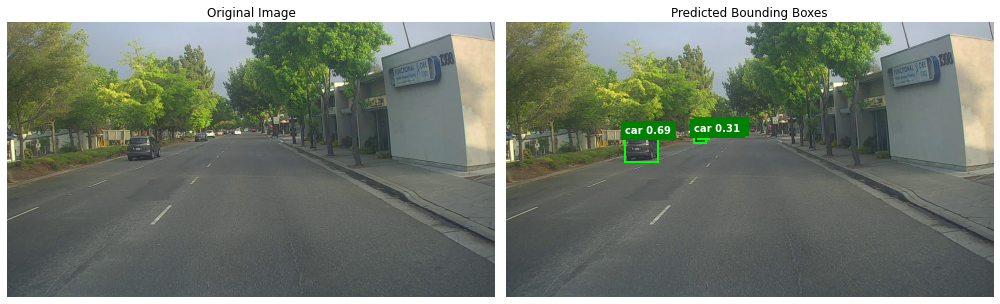

Processing: 0040.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (2, 4)
scores shape: (2,)
classes shape: (2,)


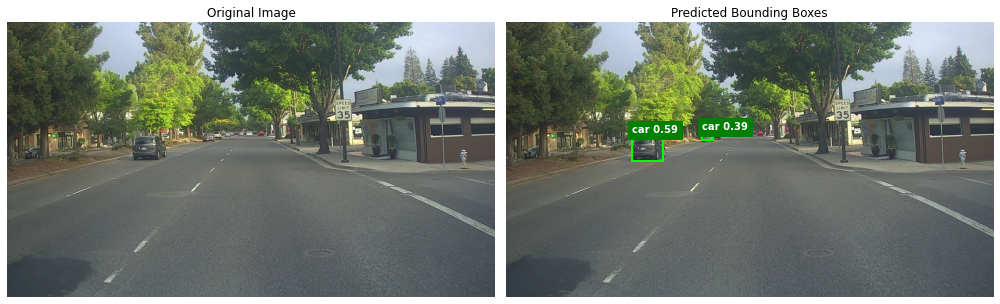

Processing: 0041.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (2, 4)
scores shape: (2,)
classes shape: (2,)


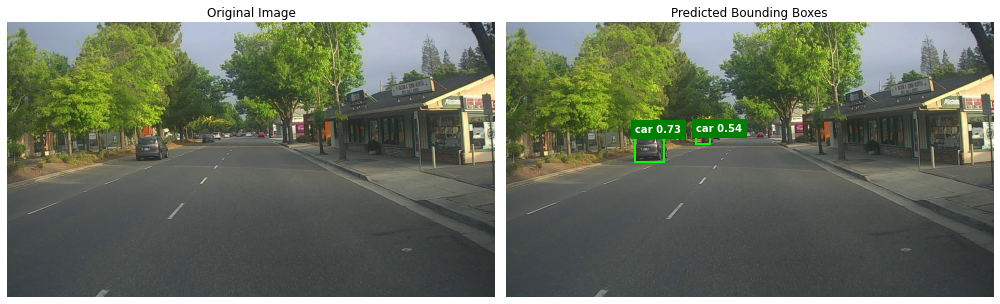

Processing: 0042.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (5, 4)
scores shape: (5,)
classes shape: (5,)


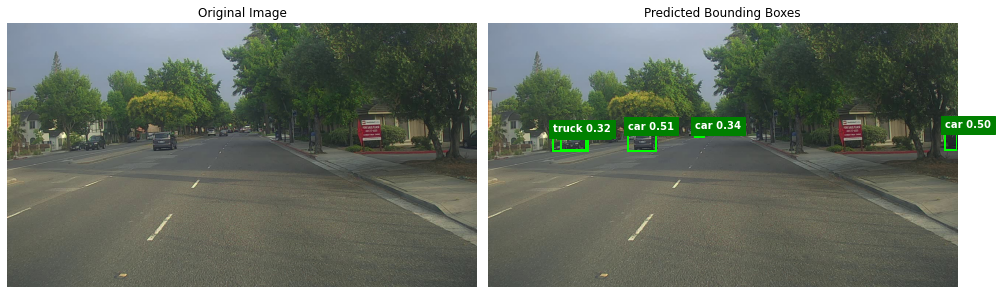

Processing: 0043.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (5, 4)
scores shape: (5,)
classes shape: (5,)


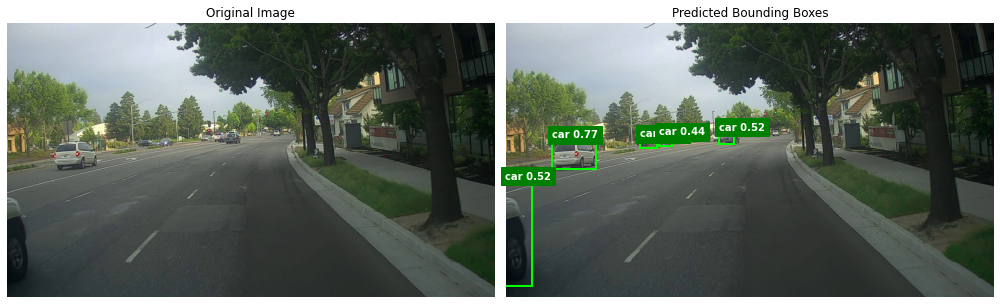

Processing: 0044.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (5, 4)
scores shape: (5,)
classes shape: (5,)


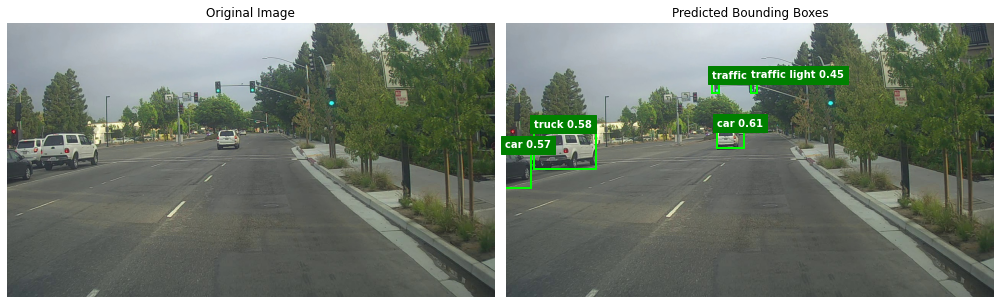

Processing: 0045.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (6, 4)
scores shape: (6,)
classes shape: (6,)


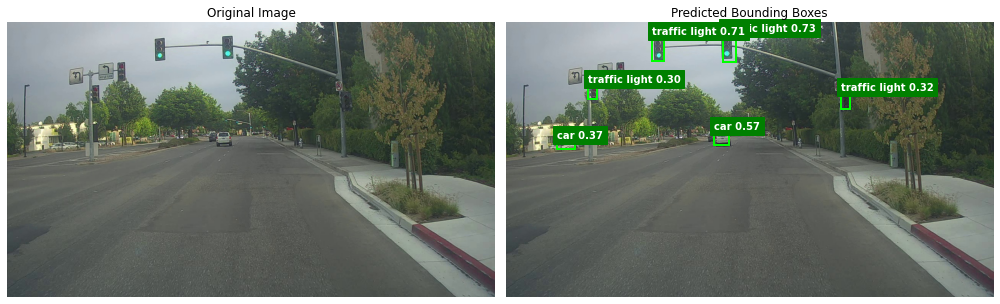

Processing: 0046.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (4, 4)
scores shape: (4,)
classes shape: (4,)


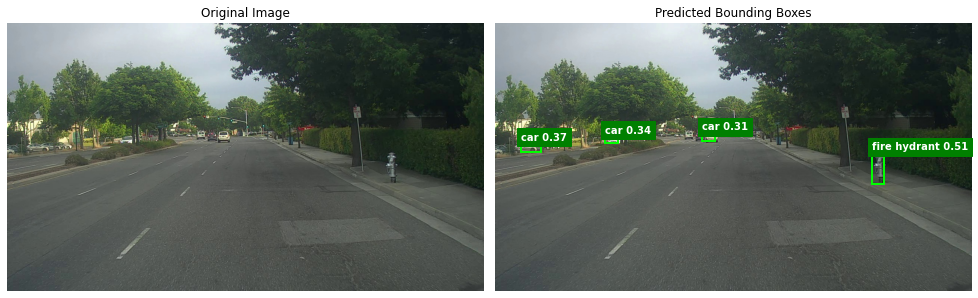

Processing: 0047.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (2, 4)
scores shape: (2,)
classes shape: (2,)


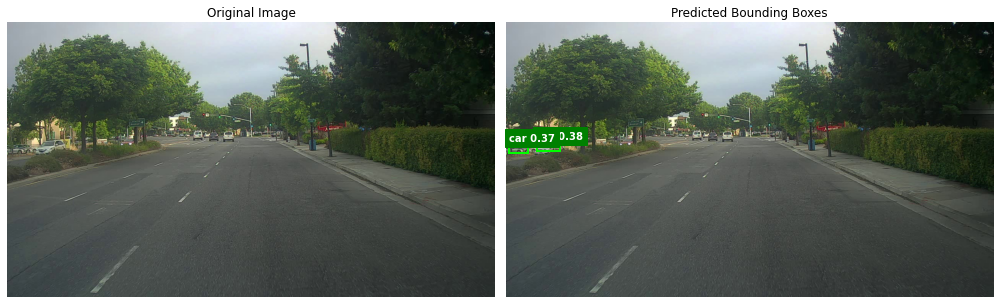

Processing: 0048.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (3, 4)
scores shape: (3,)
classes shape: (3,)


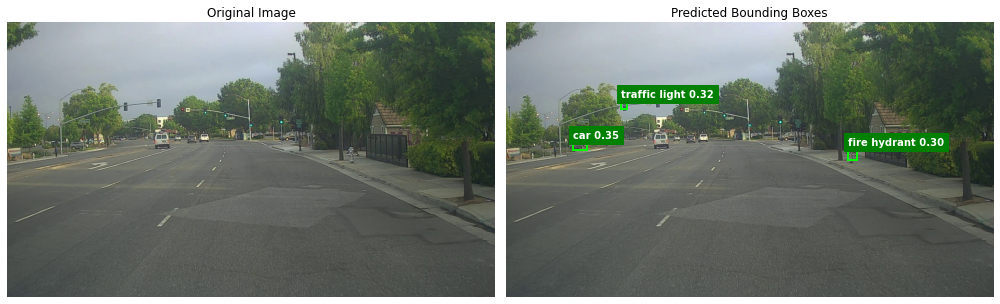

Processing: 0049.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (1, 4)
scores shape: (1,)
classes shape: (1,)


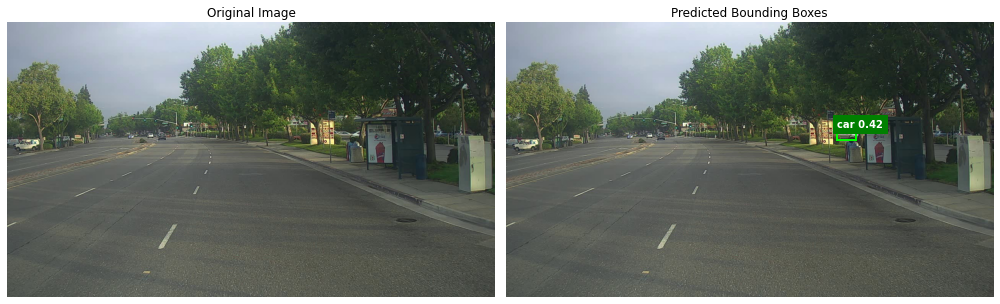

Processing: 0050.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (2, 4)
scores shape: (2,)
classes shape: (2,)


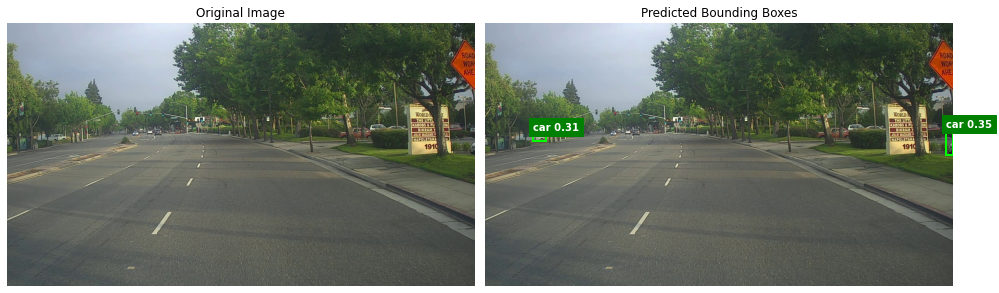

Processing: 0051.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (8, 4)
scores shape: (8,)
classes shape: (8,)


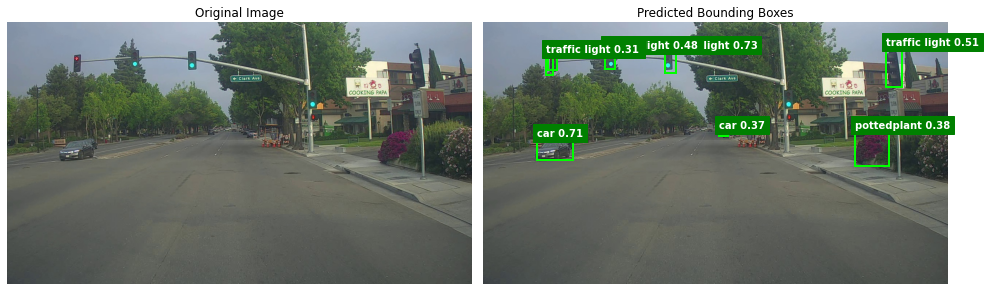

Processing: 0052.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (2, 4)
scores shape: (2,)
classes shape: (2,)


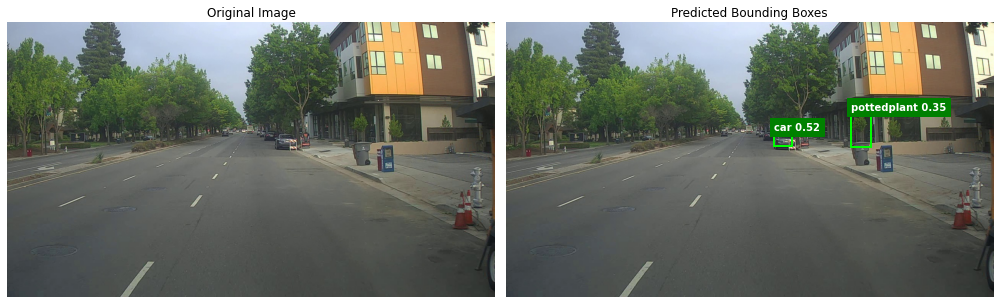

Processing: 0053.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (6, 4)
scores shape: (6,)
classes shape: (6,)


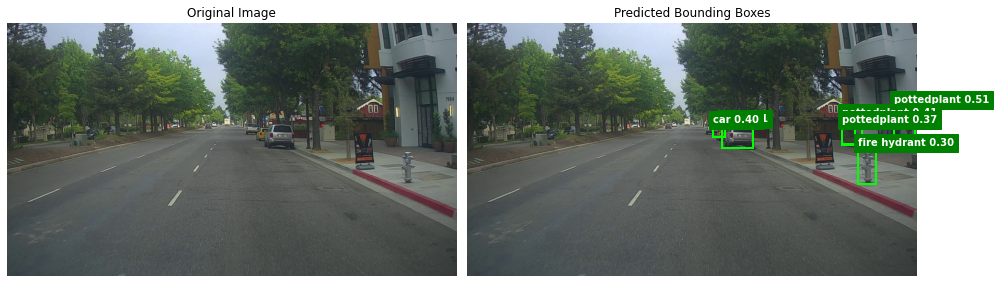

Processing: 0054.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (5, 4)
scores shape: (5,)
classes shape: (5,)


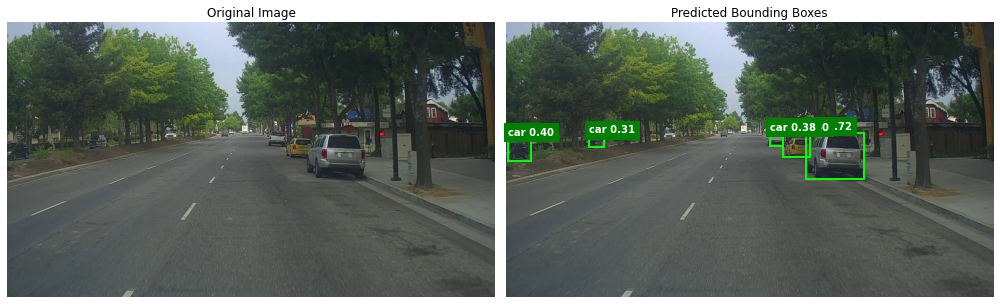

Processing: 0055.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (2, 4)
scores shape: (2,)
classes shape: (2,)


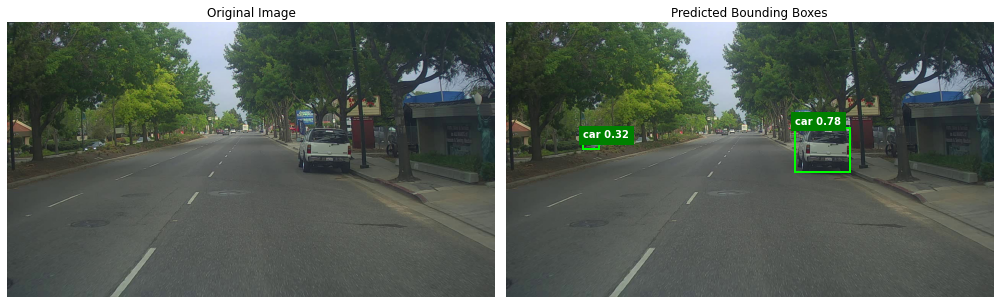

Processing: 0056.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (5, 4)
scores shape: (5,)
classes shape: (5,)


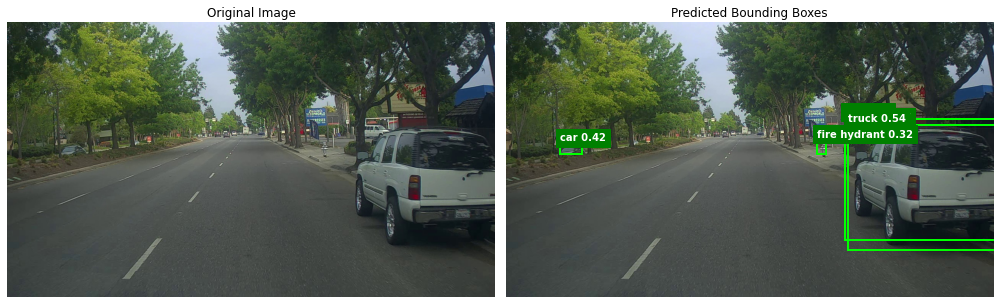

Processing: 0057.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (1, 4)
scores shape: (1,)
classes shape: (1,)


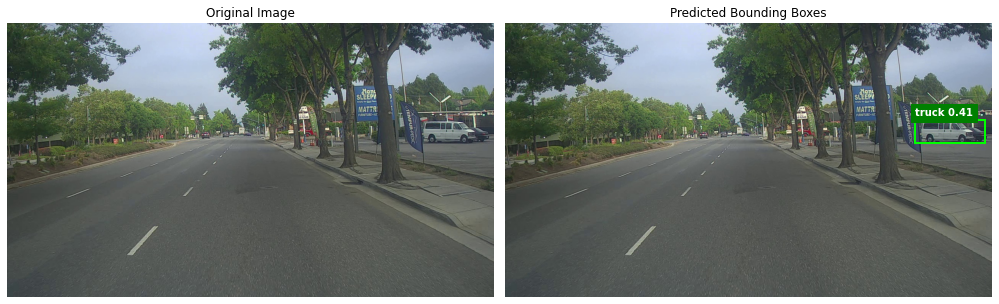

Processing: 0058.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (0, 4)
scores shape: (0,)
classes shape: (0,)


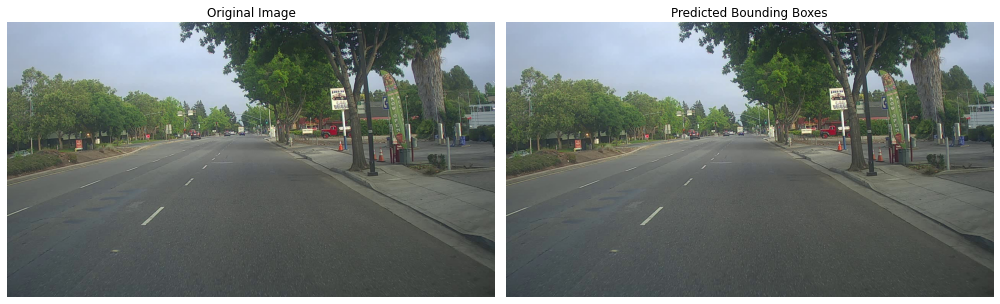

Processing: 0059.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (5, 4)
scores shape: (5,)
classes shape: (5,)


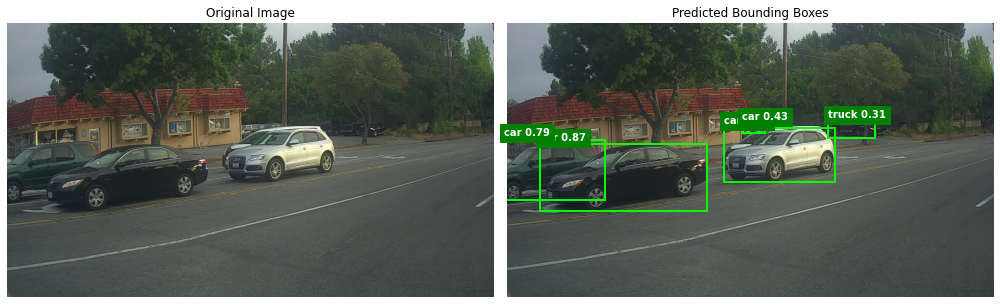

Processing: 0060.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (0, 4)
scores shape: (0,)
classes shape: (0,)


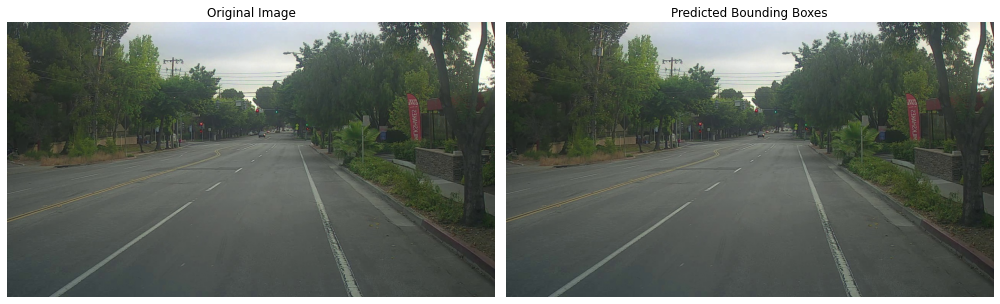

Processing: 0061.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (0, 4)
scores shape: (0,)
classes shape: (0,)


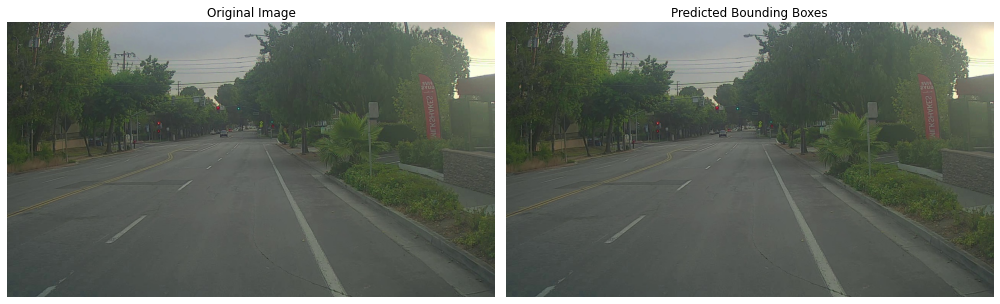

Processing: 0062.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (8, 4)
scores shape: (8,)
classes shape: (8,)


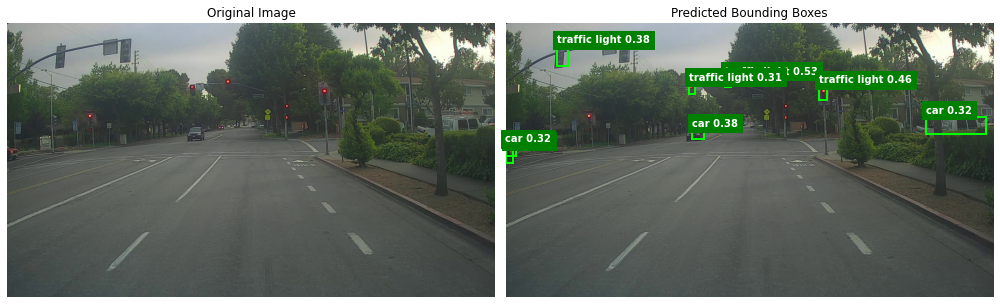

Processing: 0063.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (7, 4)
scores shape: (7,)
classes shape: (7,)


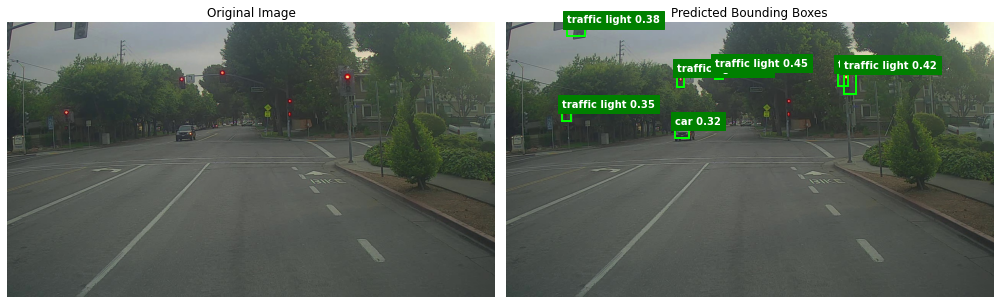

Processing: 0064.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (6, 4)
scores shape: (6,)
classes shape: (6,)


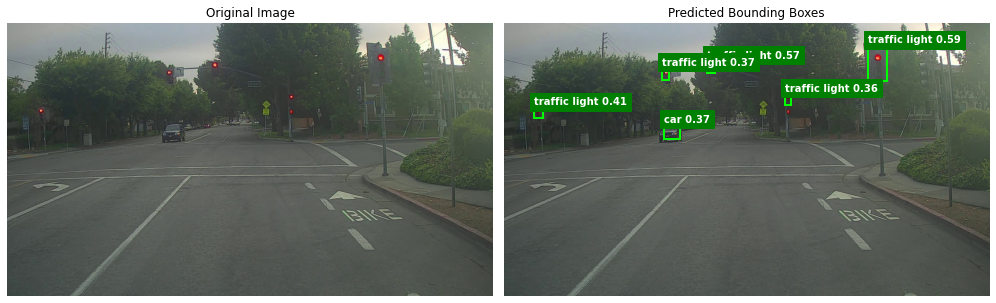

Processing: 0065.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (7, 4)
scores shape: (7,)
classes shape: (7,)


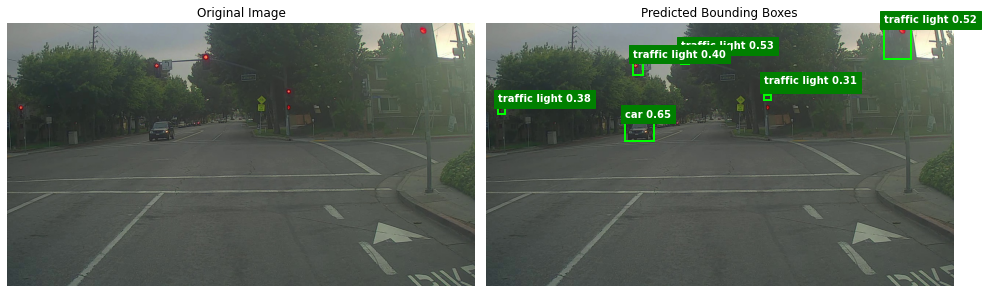

Processing: 0066.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (7, 4)
scores shape: (7,)
classes shape: (7,)


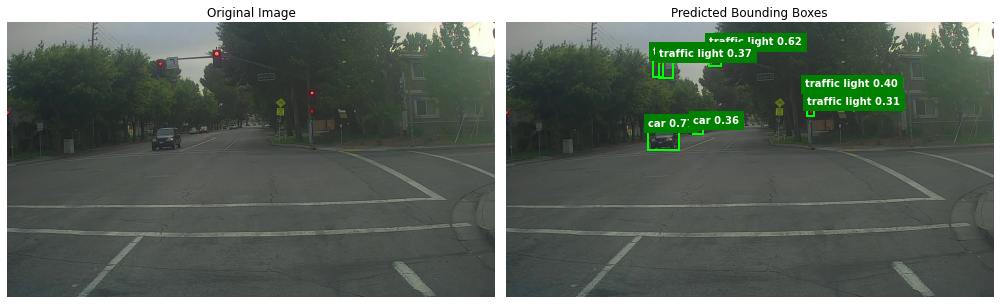

Processing: 0067.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (7, 4)
scores shape: (7,)
classes shape: (7,)


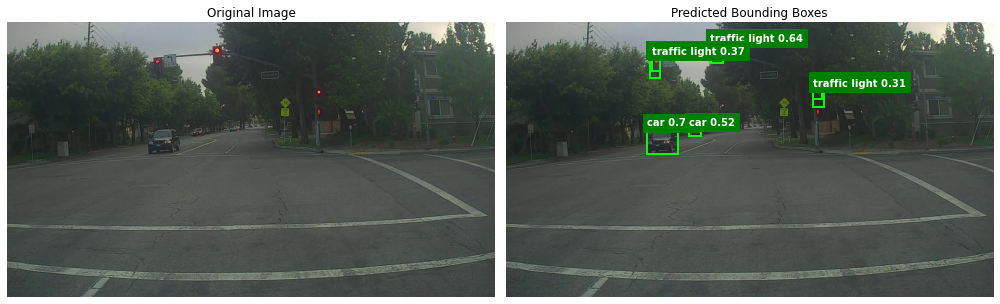

Processing: 0068.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (6, 4)
scores shape: (6,)
classes shape: (6,)


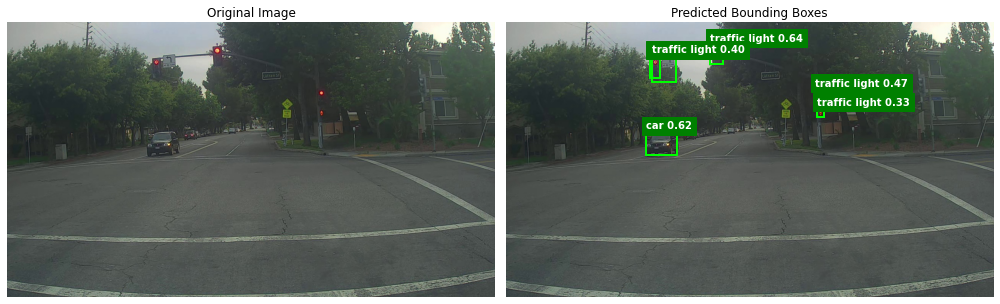

Processing: 0069.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (8, 4)
scores shape: (8,)
classes shape: (8,)


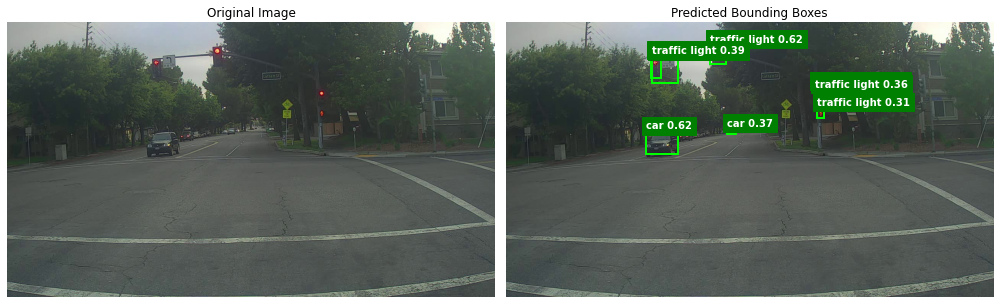

Processing: 0070.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (7, 4)
scores shape: (7,)
classes shape: (7,)


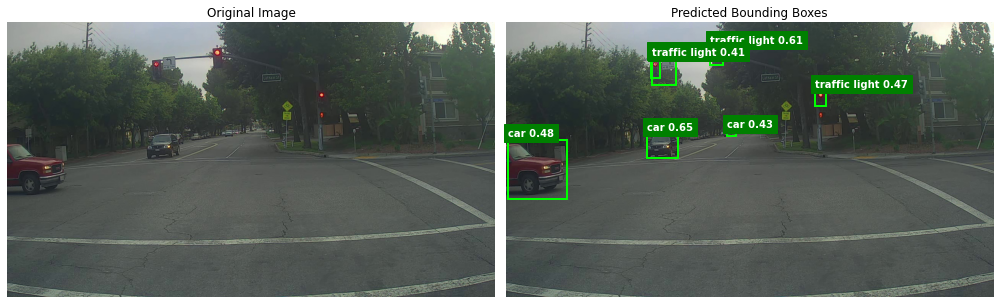

Processing: 0071.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (6, 4)
scores shape: (6,)
classes shape: (6,)


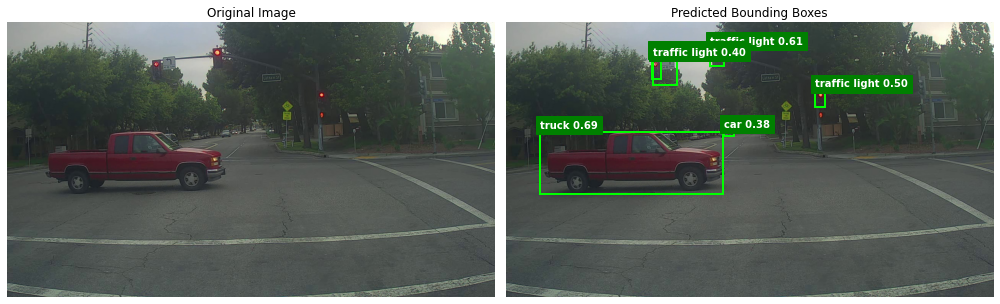

Processing: 0072.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (8, 4)
scores shape: (8,)
classes shape: (8,)


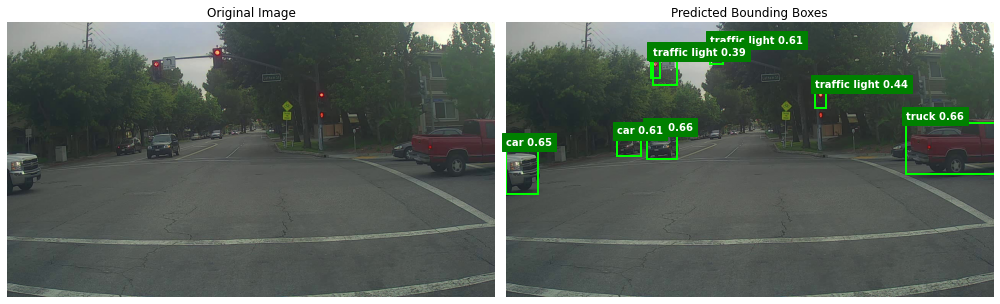

Processing: 0073.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (8, 4)
scores shape: (8,)
classes shape: (8,)


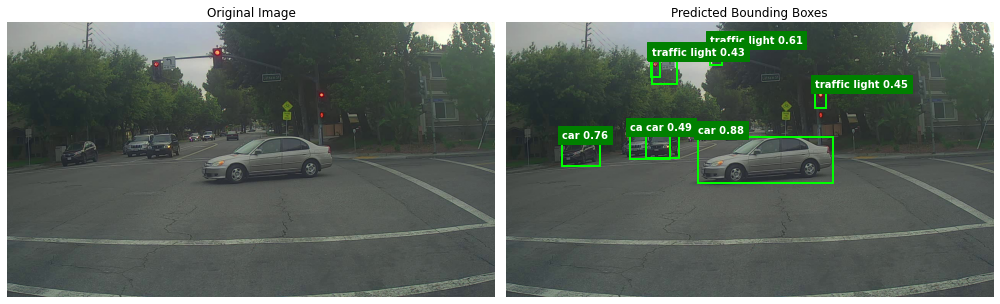

Processing: 0074.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (10, 4)
scores shape: (10,)
classes shape: (10,)


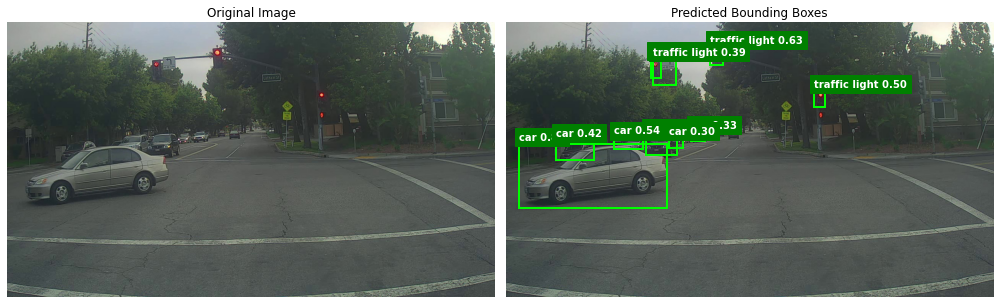

Processing: 0075.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (7, 4)
scores shape: (7,)
classes shape: (7,)


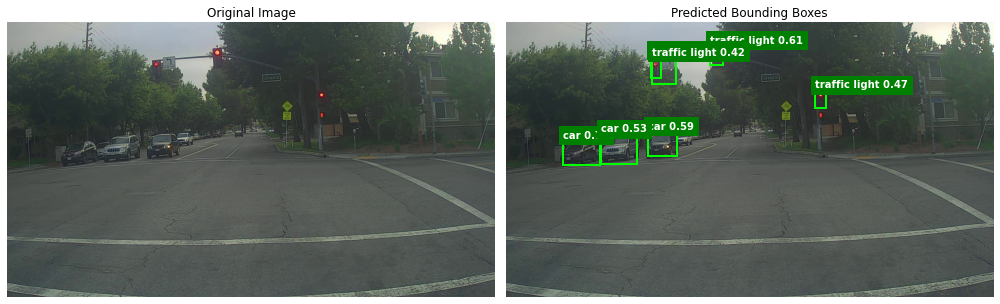

Processing: 0076.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (9, 4)
scores shape: (9,)
classes shape: (9,)


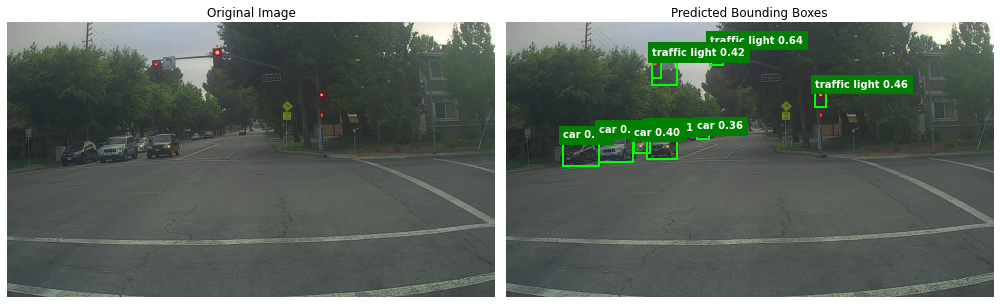

Processing: 0077.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (8, 4)
scores shape: (8,)
classes shape: (8,)


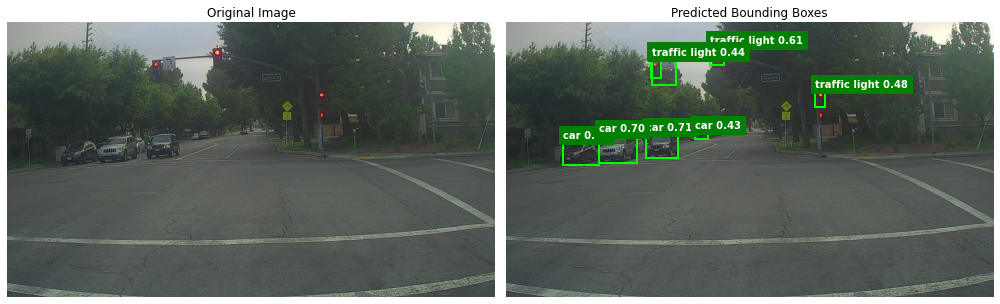

Processing: 0078.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (8, 4)
scores shape: (8,)
classes shape: (8,)


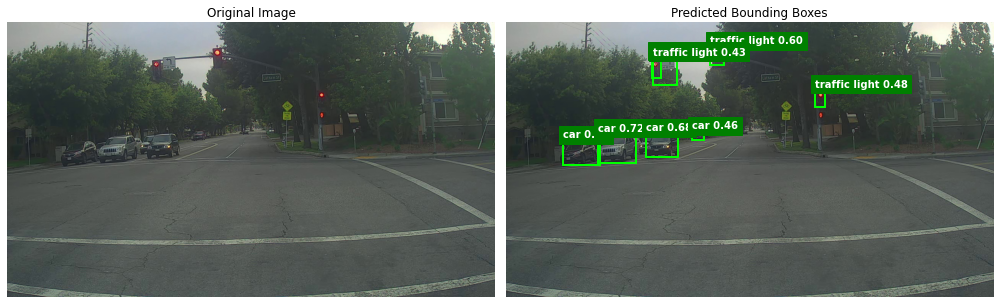

Processing: 0079.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (8, 4)
scores shape: (8,)
classes shape: (8,)


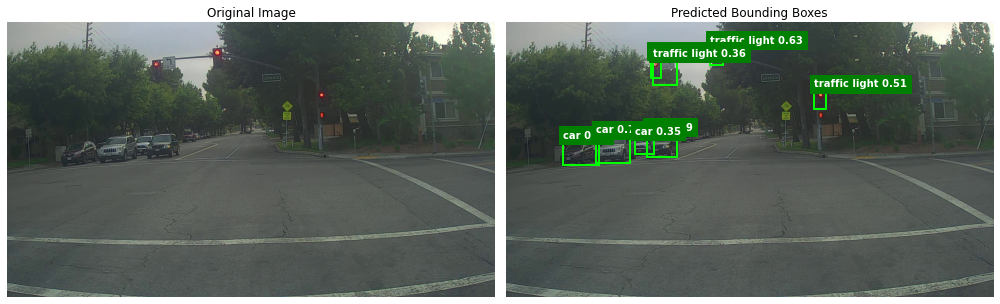

Processing: 0080.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (11, 4)
scores shape: (11,)
classes shape: (11,)


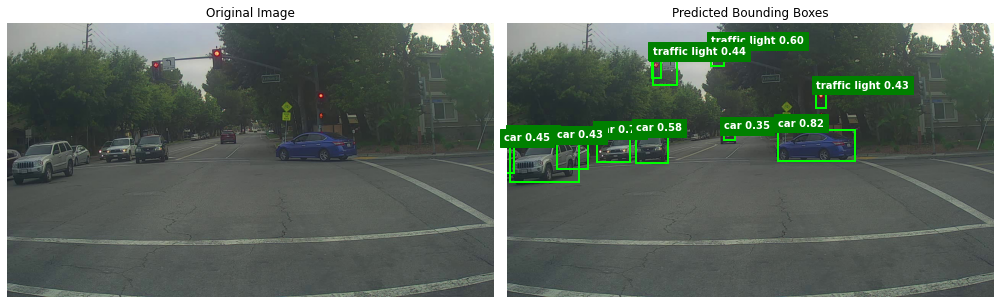

Processing: 0081.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (10, 4)
scores shape: (10,)
classes shape: (10,)


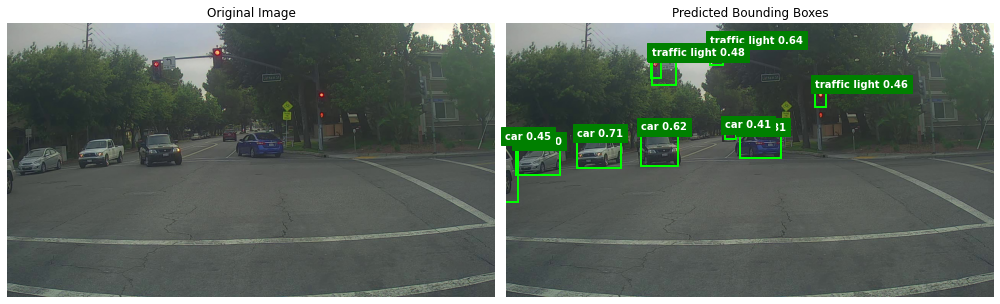

Processing: 0082.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (10, 4)
scores shape: (10,)
classes shape: (10,)


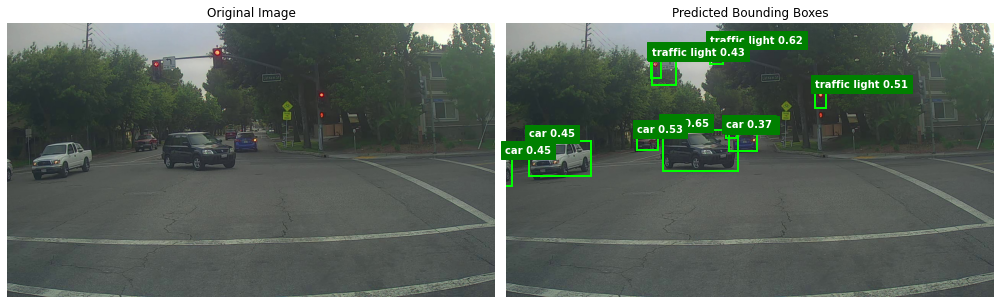

Processing: 0083.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (8, 4)
scores shape: (8,)
classes shape: (8,)


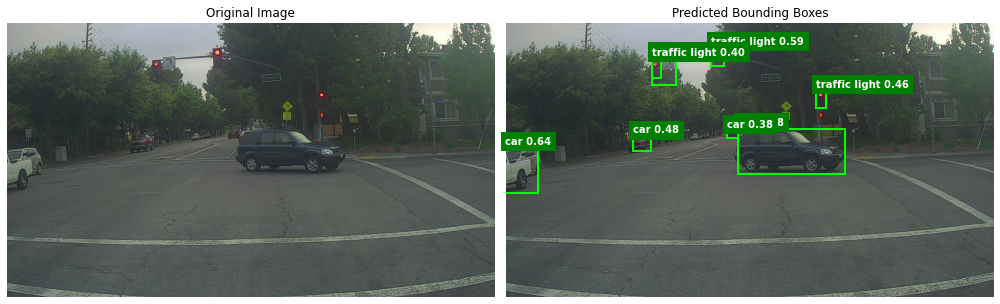

Processing: 0084.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (8, 4)
scores shape: (8,)
classes shape: (8,)


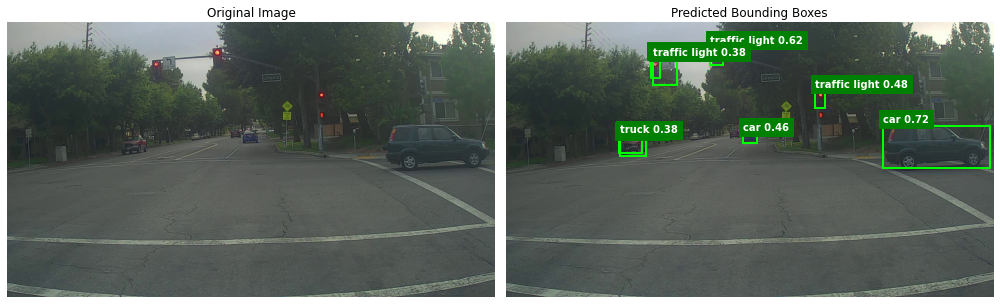

Processing: 0085.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (5, 4)
scores shape: (5,)
classes shape: (5,)


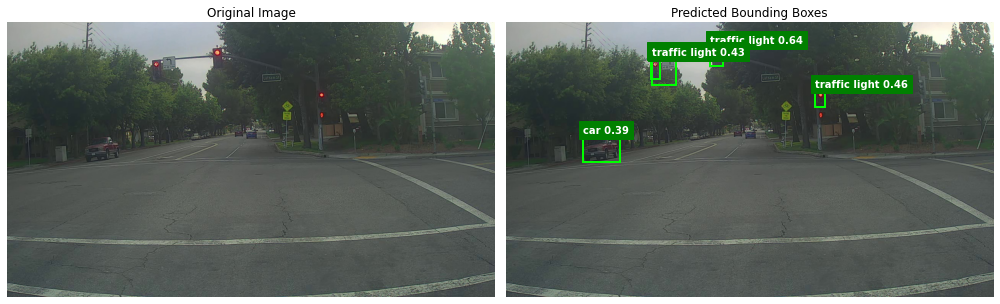

Processing: 0086.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (5, 4)
scores shape: (5,)
classes shape: (5,)


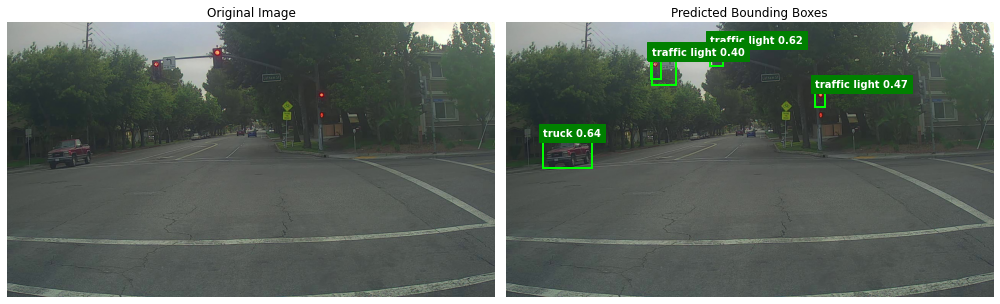

Processing: 0087.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (5, 4)
scores shape: (5,)
classes shape: (5,)


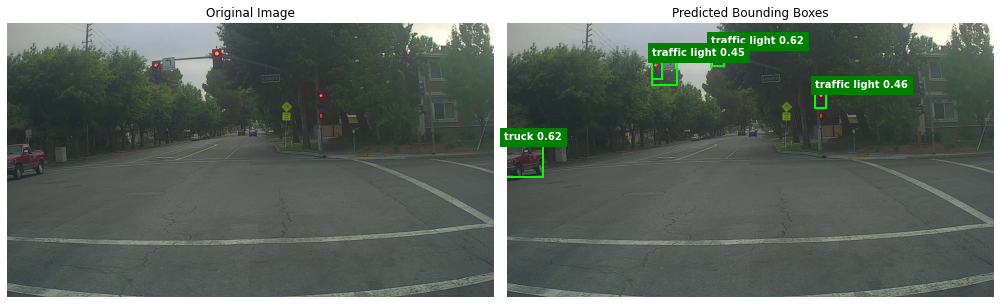

Processing: 0088.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (4, 4)
scores shape: (4,)
classes shape: (4,)


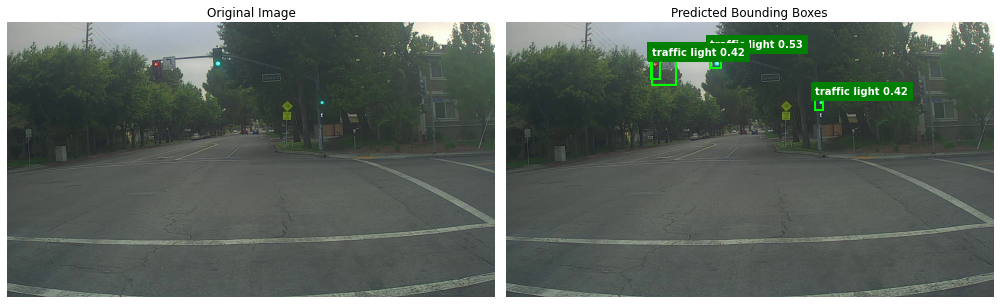

Processing: 0089.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (4, 4)
scores shape: (4,)
classes shape: (4,)


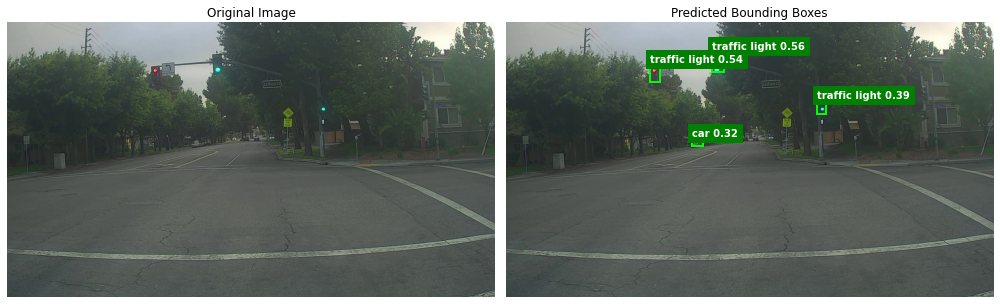

Processing: 0090.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (3, 4)
scores shape: (3,)
classes shape: (3,)


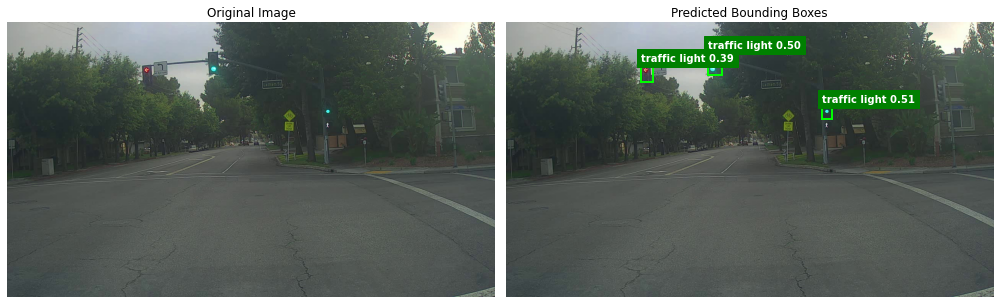

Processing: 0091.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (4, 4)
scores shape: (4,)
classes shape: (4,)


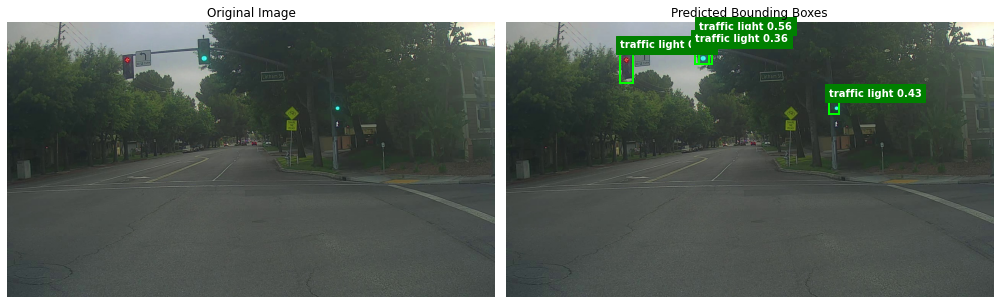

Processing: 0092.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (6, 4)
scores shape: (6,)
classes shape: (6,)


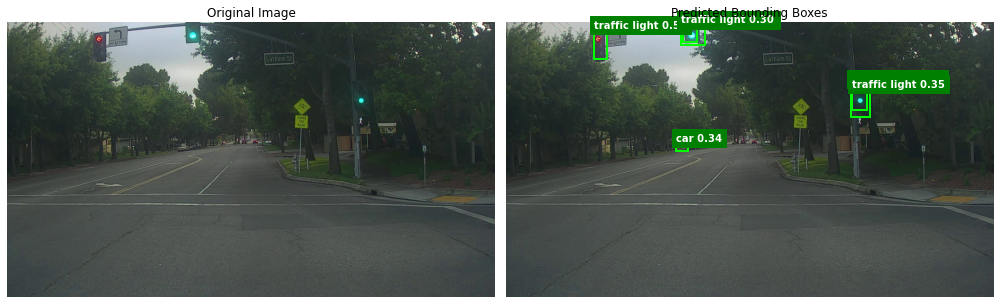

Processing: 0093.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (4, 4)
scores shape: (4,)
classes shape: (4,)


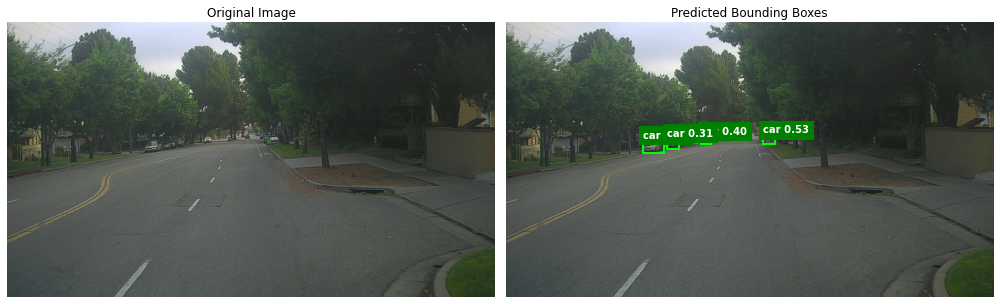

Processing: 0094.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (4, 4)
scores shape: (4,)
classes shape: (4,)


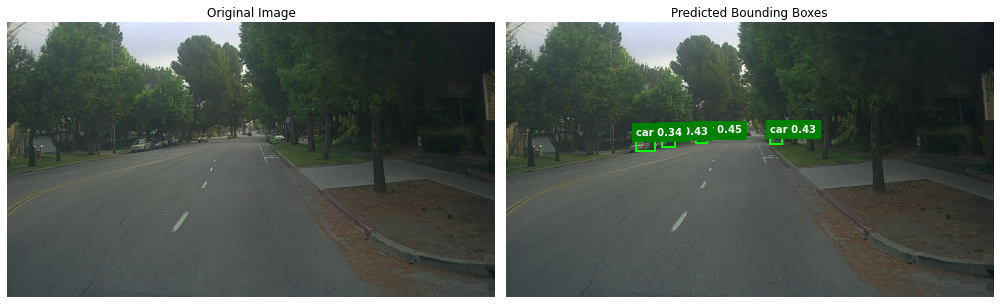

Processing: 0095.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (4, 4)
scores shape: (4,)
classes shape: (4,)


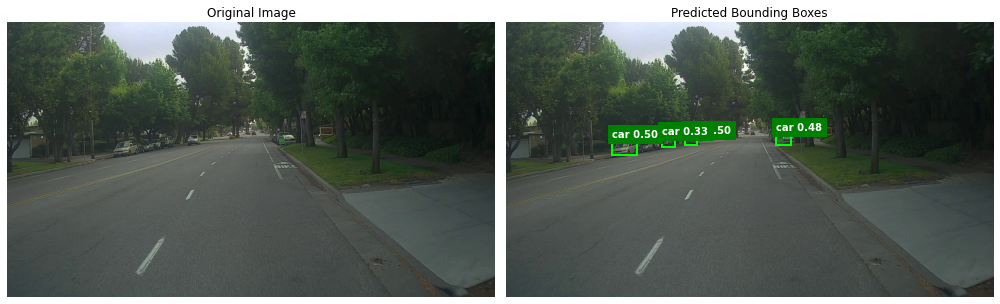

Processing: 0096.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (5, 4)
scores shape: (5,)
classes shape: (5,)


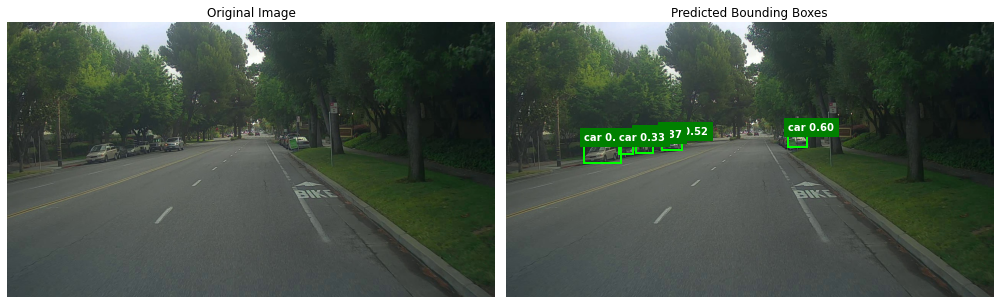

Processing: 0097.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (6, 4)
scores shape: (6,)
classes shape: (6,)


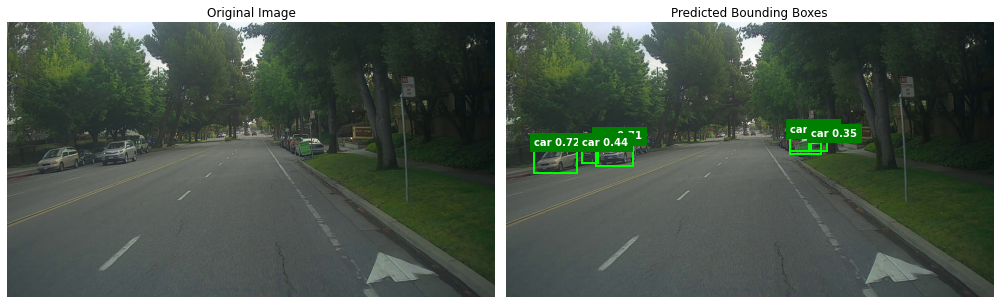

Processing: 0098.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (6, 4)
scores shape: (6,)
classes shape: (6,)


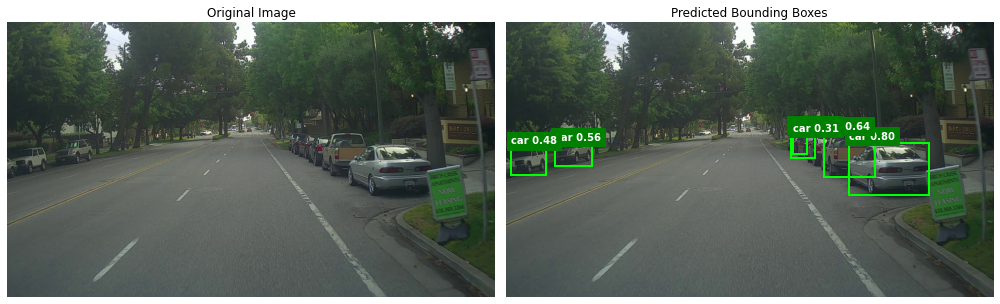

Processing: 0099.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (5, 4)
scores shape: (5,)
classes shape: (5,)


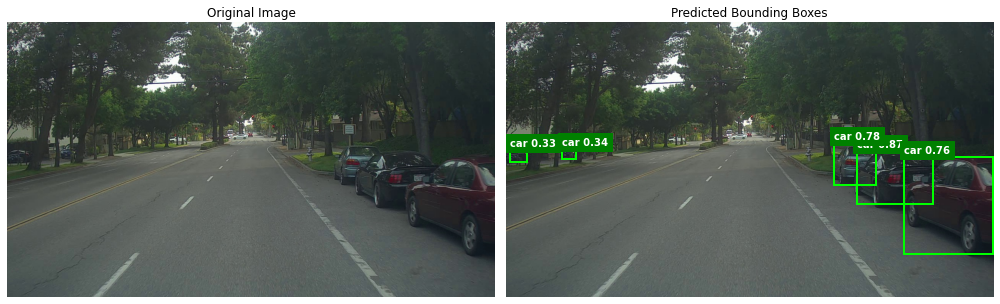

Processing: 0100.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (1, 4)
scores shape: (1,)
classes shape: (1,)


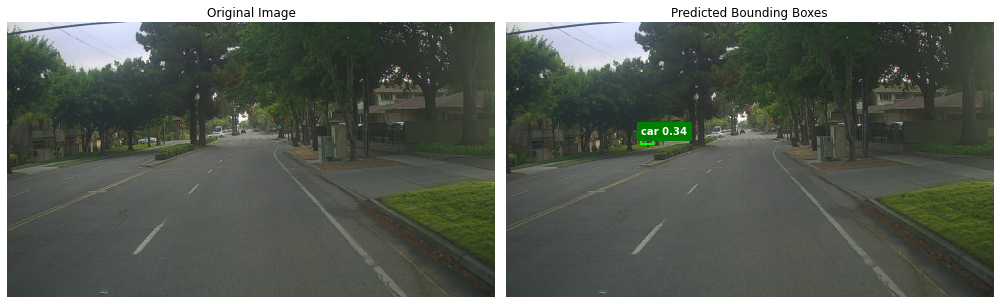

Processing: 0101.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (2, 4)
scores shape: (2,)
classes shape: (2,)


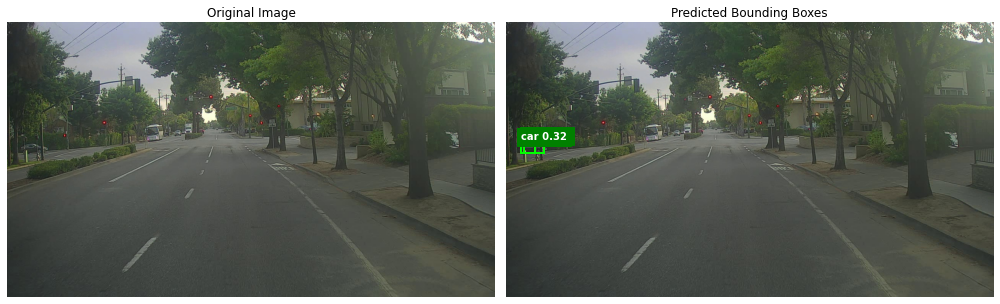

Processing: 0102.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (9, 4)
scores shape: (9,)
classes shape: (9,)


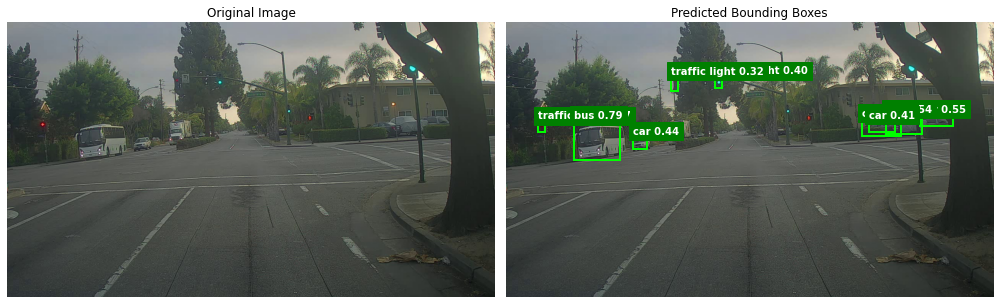

Processing: 0103.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (6, 4)
scores shape: (6,)
classes shape: (6,)


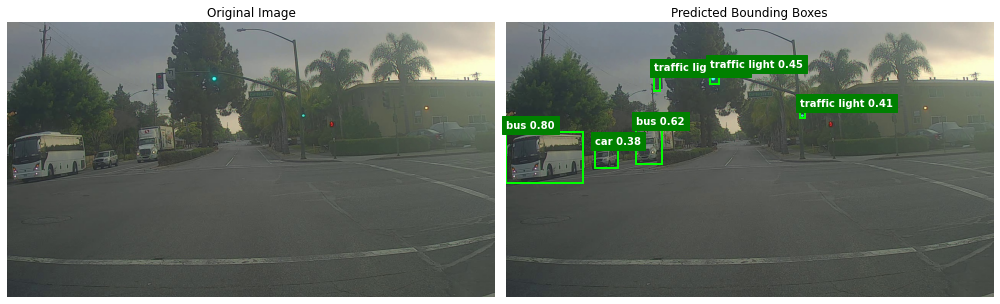

Processing: 0104.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (6, 4)
scores shape: (6,)
classes shape: (6,)


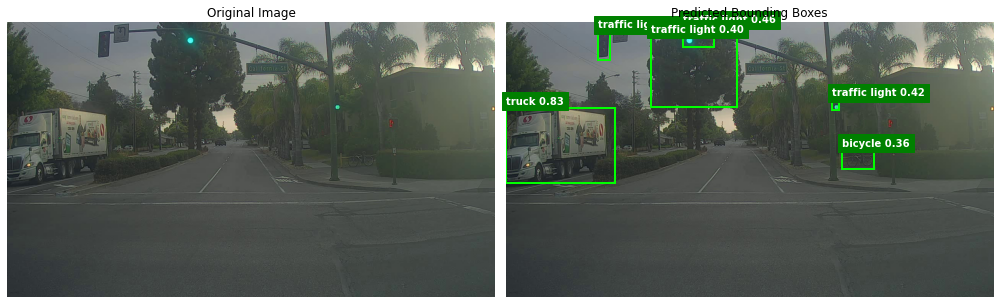

Processing: 0105.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (3, 4)
scores shape: (3,)
classes shape: (3,)


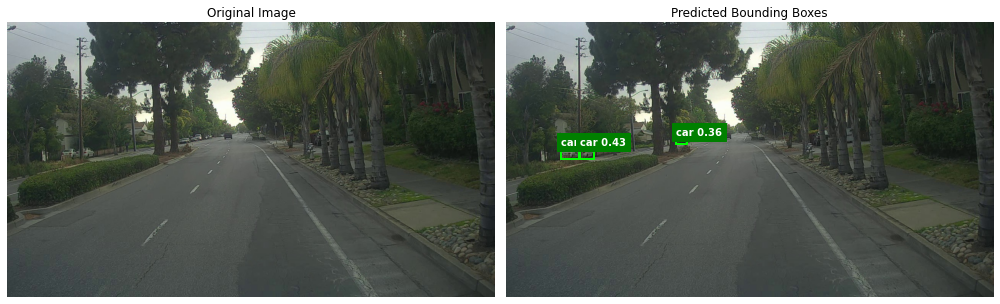

Processing: 0106.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (2, 4)
scores shape: (2,)
classes shape: (2,)


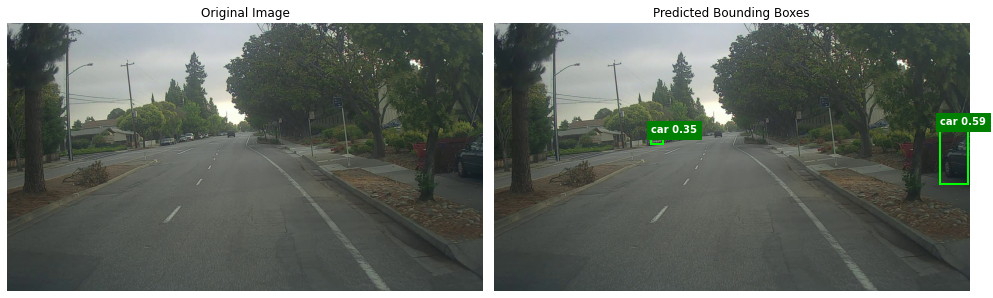

Processing: 0107.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (1, 4)
scores shape: (1,)
classes shape: (1,)


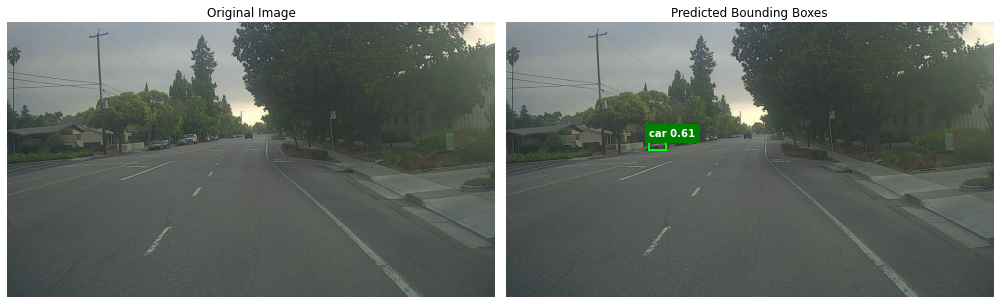

Processing: 0108.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (2, 4)
scores shape: (2,)
classes shape: (2,)


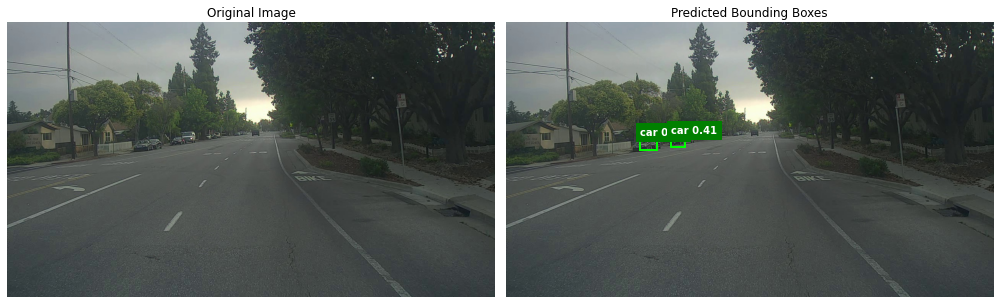

Processing: 0109.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (5, 4)
scores shape: (5,)
classes shape: (5,)


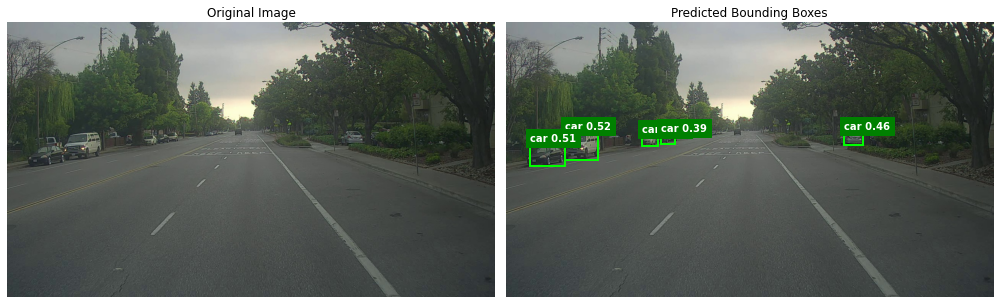

Processing: 0110.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (4, 4)
scores shape: (4,)
classes shape: (4,)


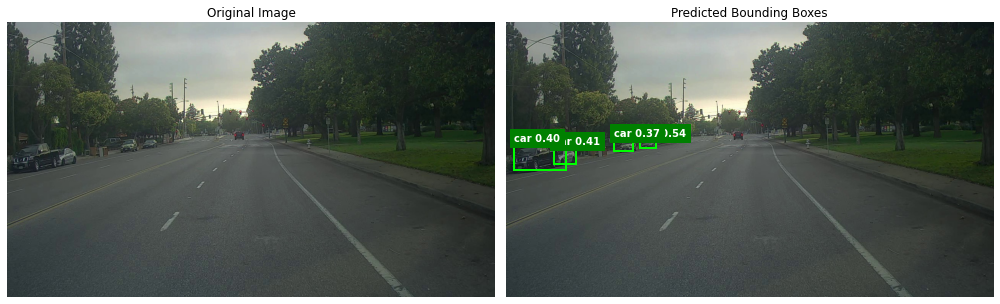

Processing: 0111.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (5, 4)
scores shape: (5,)
classes shape: (5,)


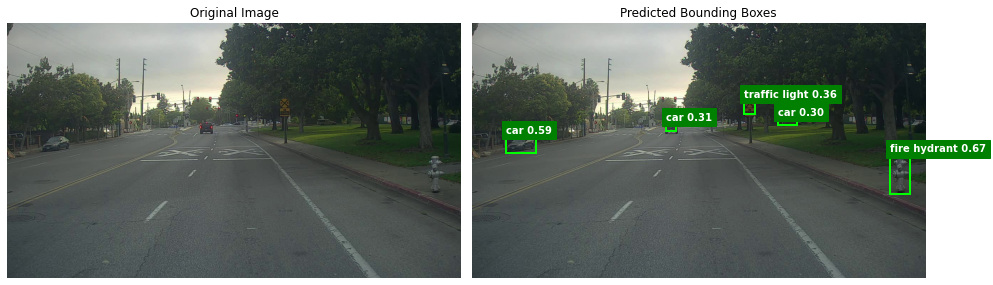

Processing: 0112.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (3, 4)
scores shape: (3,)
classes shape: (3,)


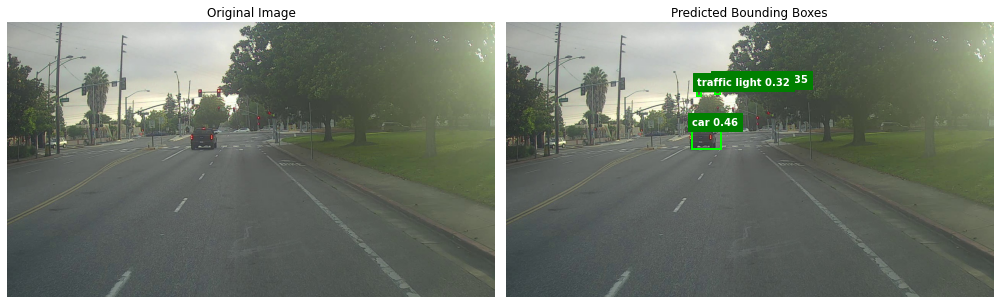

Processing: 0113.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (8, 4)
scores shape: (8,)
classes shape: (8,)


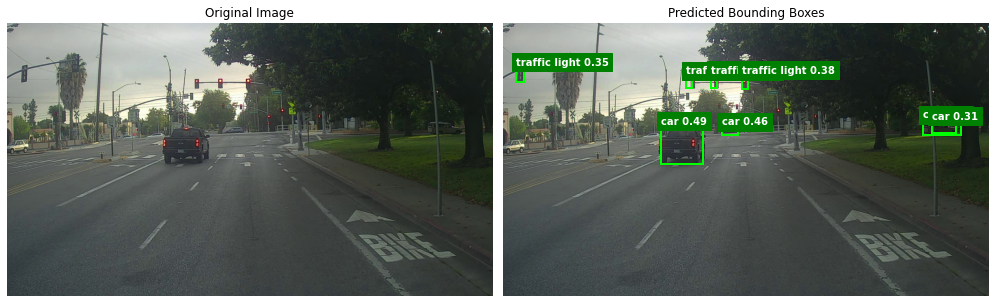

Processing: 0114.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (7, 4)
scores shape: (7,)
classes shape: (7,)


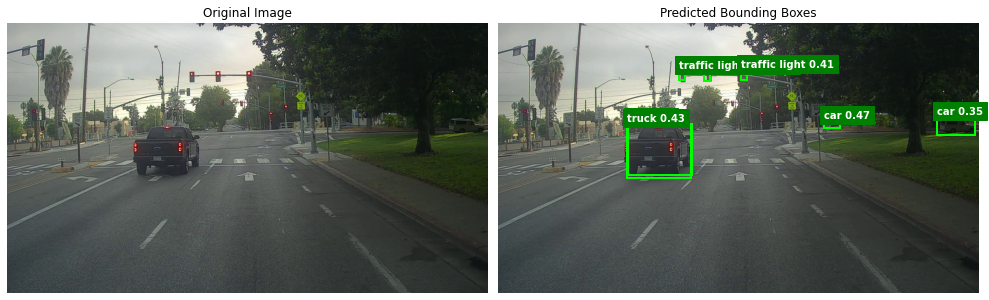

Processing: 0115.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (11, 4)
scores shape: (11,)
classes shape: (11,)


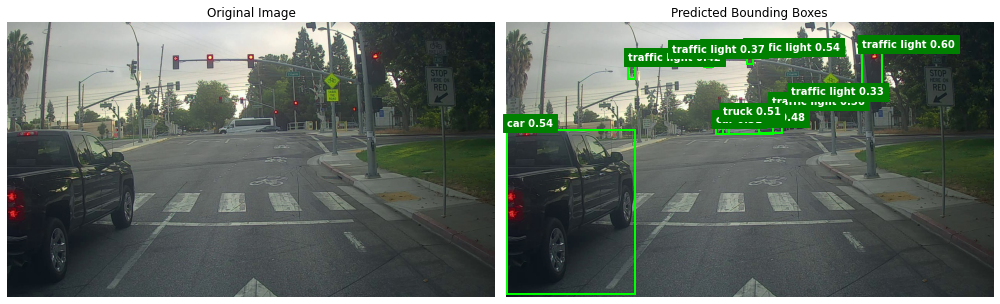

Processing: 0116.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (12, 4)
scores shape: (12,)
classes shape: (12,)


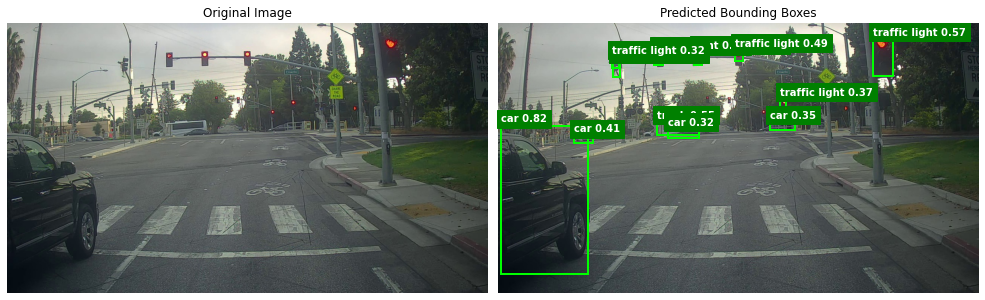

Processing: 0117.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (9, 4)
scores shape: (9,)
classes shape: (9,)


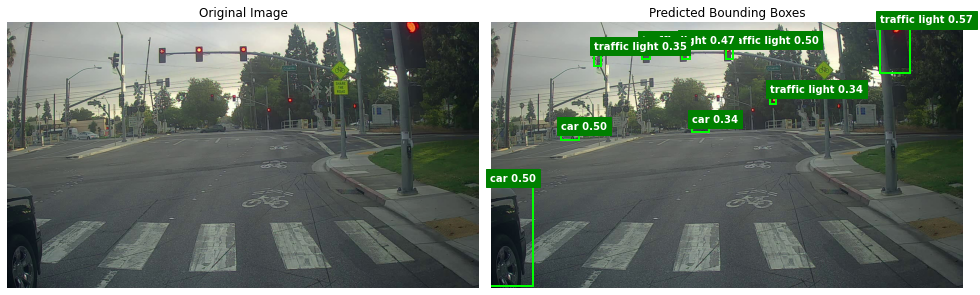

Processing: 0118.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (10, 4)
scores shape: (10,)
classes shape: (10,)


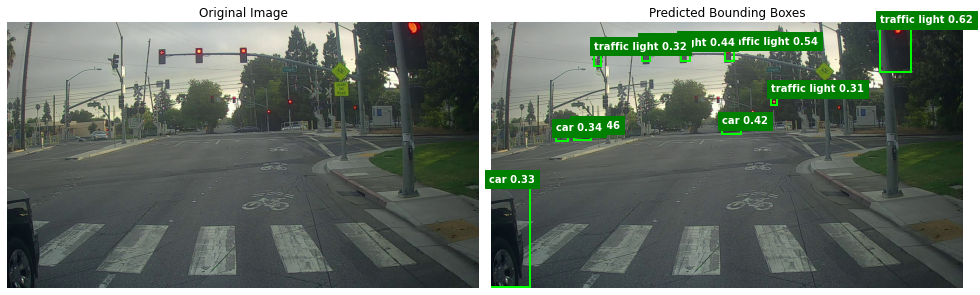

Processing: 0119.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (13, 4)
scores shape: (13,)
classes shape: (13,)


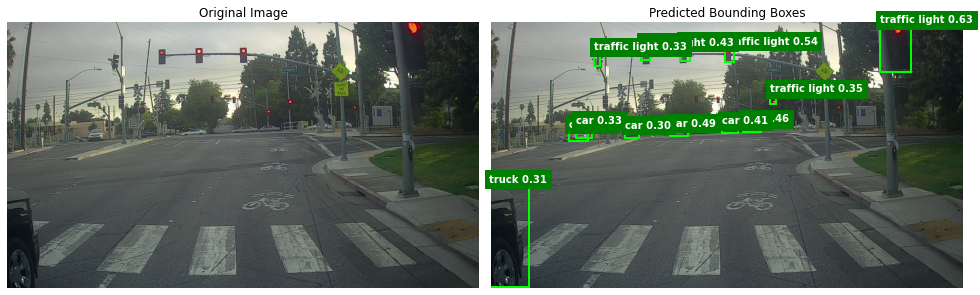

Processing: 0120.jpg
YOLO Input: (Input Image) (1, 608, 608, 3)
YOLO Raw Output: (From model) (1, 19, 19, 425)
[yolo_head] feats reshaped: (1, 19, 19, 5, 85)
YOLO Raw Output Processed (From yolo_head): (4, 1, 19, 19, 5)
box_xy shape: (1, 19, 19, 5, 2)
box_wh shape: (1, 19, 19, 5, 2)
box_confidence shape: (1, 19, 19, 5, 1)
box_class_probs shape: (1, 19, 19, 5, 80)
--------------------------------------------------
--------------------------------------------------
From yolo_eval
boxes shape: (11, 4)
scores shape: (11,)
classes shape: (11,)


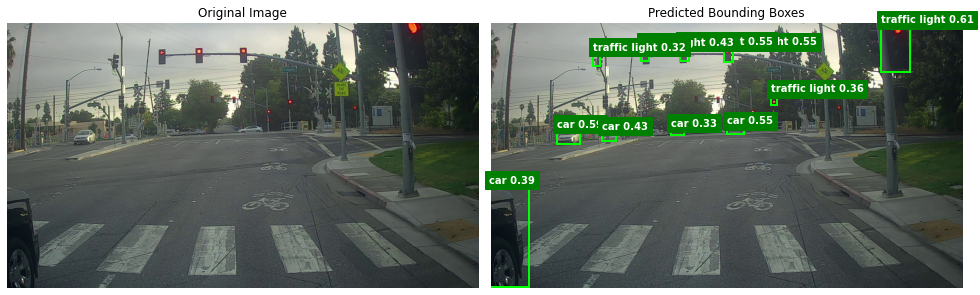

In [46]:
import os
import matplotlib.pyplot as plt
from matplotlib import patches
from PIL import Image

# Directories
image_folder = 'images'
originals_dir = 'originals'
predictions_dir = 'predictions'
image_size = (608, 608)

os.makedirs(originals_dir, exist_ok=True)
os.makedirs(predictions_dir, exist_ok=True)

for i in range(121):
    filename = f"{i:04}.jpg"
    img_path = os.path.join(image_folder, filename)

    if not os.path.exists(img_path):
        print(f"Image not found: {img_path}")
        continue

    print(f"Processing: {filename}")

    # Run YOLO prediction
    out_boxes, out_scores, out_classes = predict(img_path, yolo_model, class_names, anchors, image_size)

    # Load and save original image
    original_image = Image.open(img_path)
    original_save_path = os.path.join(originals_dir, filename)
    original_image.save(original_save_path)

    # --- Create and Save Prediction Image Only ---
    pred_image = original_image.copy()
    fig_pred, ax_pred = plt.subplots(figsize=(8, 8))
    ax_pred.imshow(pred_image)

    for box, score, cls in zip(out_boxes, out_scores, out_classes):
        top, left, bottom, right = box
        class_id = int(cls)
        class_name = class_names[class_id]
        label = f"{class_name} {score:.2f}"

        # bounding box
        rect = patches.Rectangle((left, top), right - left, bottom - top,
                                 linewidth=2, edgecolor='lime', facecolor='none')
        ax_pred.add_patch(rect)

        text_y = max(top - 20, 0)
        ax_pred.text(left, text_y, label, color='white', backgroundcolor='green',
                     fontsize=10, weight='bold')

    ax_pred.axis('off')
    plt.tight_layout(pad=0)
    pred_save_path = os.path.join(predictions_dir, filename)
    plt.savefig(pred_save_path, bbox_inches='tight', pad_inches=0)
    plt.close(fig_pred)

    plt.figure(figsize=(14, 6))

    # Original
    plt.subplot(1, 2, 1)
    plt.imshow(original_image)
    plt.title("Original Image")
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(pred_image)
    ax_display = plt.gca()

    for box, score, cls in zip(out_boxes, out_scores, out_classes):
        top, left, bottom, right = box
        class_id = int(cls)
        class_name = class_names[class_id]
        label = f"{class_name} {score:.2f}"
        rect = patches.Rectangle((left, top), right - left, bottom - top,
                                 linewidth=2, edgecolor='lime', facecolor='none')
        ax_display.add_patch(rect)
        text_y = max(top - 10, 0)
        ax_display.text(left, text_y, label, color='white', backgroundcolor='green',
                        fontsize=10, weight='bold')

    plt.title("Predicted Bounding Boxes")
    plt.axis('off')
    plt.tight_layout()
    plt.show()